<a href="https://colab.research.google.com/github/srikannyaroy/DL-assignment/blob/main/MRM2024009_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ==============================================
# COMPARATIVE ANALYSIS OF 5 GAN VARIANTS ON MNIST
# ==============================================

In [ ]:
!pip install torch torchvision  # Should already be present in most Colab environments
# If you'd like to compute FID, also do:
# !pip install pytorch-fid

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.autograd import Variable, grad
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import torchvision.utils as vutils

import matplotlib.pyplot as plt
import numpy as np
import os

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 52.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 18.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 31.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 40.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda




# --------------------
#  Hyperparameters
# --------------------

In [ ]:

batch_size = 64
latent_dim = 100
lr = 0.0002
num_epochs = 25  # Increase for better results (e.g. 25, 50, 100)
img_size = 28
channels_img = 1
sample_interval = 1  # Show images every epoch (set higher if you prefer fewer logs)



# --------------------
#  Dataset & Dataloader
# --------------------

In [ ]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])
mnist_data = datasets.MNIST(root='.', train=True, transform=transform, download=True)
dataloader = DataLoader(mnist_data, batch_size=batch_size, shuffle=True)

100%|██████████| 9.91M/9.91M [00:00<00:00, 13.4MB/s]
100%|██████████| 28.9k/28.9k [00:00<00:00, 477kB/s]
100%|██████████| 1.65M/1.65M [00:00<00:00, 4.49MB/s]
100%|██████████| 4.54k/4.54k [00:00<00:00, 10.0MB/s]




# -----------------------------------
#  1) VANILLA GAN Architectures
# -----------------------------------

In [ ]:
class Vanilla_Generator(nn.Module):
    def __init__(self, latent_dim=100):
        super(Vanilla_Generator, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(latent_dim, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2),
            nn.Linear(1024, img_size*img_size*channels_img),
            nn.Tanh()
        )

    def forward(self, z):
        out = self.net(z)
        return out.view(-1, channels_img, img_size, img_size)

class Vanilla_Discriminator(nn.Module):
    def __init__(self):
        super(Vanilla_Discriminator, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(img_size*img_size*channels_img, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, img):
        return self.net(img.view(img.size(0), -1))



# -----------------------------------
#  2) DCGAN Architectures
# -----------------------------------
# For MNIST, we can keep things relatively small.
# Typically DCGAN uses convolutional layers (transposed conv in generator).

In [ ]:

class DCGAN_Generator(nn.Module):
    def __init__(self, latent_dim=100, ngf=64):
        super(DCGAN_Generator, self).__init__()
        # input z: (N, latent_dim, 1, 1)
        self.net = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, ngf*4, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf*4),
            nn.ReLU(True),
            # State size: (ngf*4) x 4 x 4
            nn.ConvTranspose2d(ngf*4, ngf*2, 3, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*2),
            nn.ReLU(True),
            # State size: (ngf*2) x 7 x 7
            nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # State size: (ngf) x 14 x 14
            nn.ConvTranspose2d(ngf, channels_img, 4, 2, 1, bias=False),
            nn.Tanh()
            # Output size: 1 x 28 x 28
        )

    def forward(self, z):
        # Reshape z to (N, latent_dim, 1, 1)
        z = z.view(z.size(0), -1, 1, 1)
        return self.net(z)

class DCGAN_Discriminator(nn.Module):
    def __init__(self, ndf=64):
        super(DCGAN_Discriminator, self).__init__()
        # input: (N, 1, 28, 28)
        self.net = nn.Sequential(
            nn.Conv2d(channels_img, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 14 x 14
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 7 x 7
            nn.Conv2d(ndf*2, 1, 7, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, img):
        return self.net(img).view(-1, 1)



# -----------------------------------
#  3) WGAN Architectures
#  (Similar to Vanilla/DCGAN but
#   uses linear output for D, no Sigmoid,
#   and "weight clipping" or "gradient penalty")
# -----------------------------------

In [ ]:

class WGAN_Generator(nn.Module):
    def __init__(self, latent_dim=100):
        super(WGAN_Generator, self).__init__()
        # We'll use a simple MLP again, but typically you'd use DCGAN-like conv layers
        self.net = nn.Sequential(
            nn.Linear(latent_dim, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2),
            nn.Linear(1024, img_size*img_size*channels_img),
            nn.Tanh()
        )

    def forward(self, z):
        out = self.net(z)
        return out.view(-1, channels_img, img_size, img_size)

class WGAN_Discriminator(nn.Module):
    def __init__(self):
        super(WGAN_Discriminator, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(img_size*img_size*channels_img, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 1)
            # no sigmoid
        )

    def forward(self, img):
        return self.net(img.view(img.size(0), -1))



# -----------------------------------
#  4) WGAN-GP Architectures
# -----------------------------------
# For WGAN-GP, we need the same G/D as WGAN, but with gradient penalty in training

In [ ]:

class WGAN_GP_Generator(WGAN_Generator):
    """ Reuse the same architecture as WGAN_Generator. """
    pass

class WGAN_GP_Discriminator(WGAN_Discriminator):
    """ Reuse the same architecture as WGAN_Discriminator. """
    pass



# -----------------------------------
#  5) LSGAN Architectures
#  (MSE Loss instead of BCELoss)
# -----------------------------------
# We'll just reuse the MLP from Vanilla for demonstration

In [ ]:

class LSGAN_Generator(Vanilla_Generator):
    pass

class LSGAN_Discriminator(Vanilla_Discriminator):
    pass

training vanilla gan

In [ ]:


def train_vanilla_GAN():
    """
    Trains a basic VANILLA GAN (MLP-based) on MNIST
    """
    G = Vanilla_Generator(latent_dim).to(device)
    D = Vanilla_Discriminator().to(device)

    criterion = nn.BCELoss()
    optimizer_G = optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))
    optimizer_D = optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))

    G_losses, D_losses = [], []
    fixed_noise = torch.randn(25, latent_dim, device=device)

    for epoch in range(num_epochs):
        for i, (imgs, _) in enumerate(dataloader):
            imgs = imgs.to(device)
            bs = imgs.size(0)

            valid = torch.ones(bs, 1, device=device)
            fake = torch.zeros(bs, 1, device=device)

            # Train Generator
            optimizer_G.zero_grad()
            z = torch.randn(bs, latent_dim, device=device)
            gen_imgs = G(z)
            g_loss = criterion(D(gen_imgs), valid)
            g_loss.backward()
            optimizer_G.step()

            # Train Discriminator
            optimizer_D.zero_grad()
            real_loss = criterion(D(imgs), valid)
            fake_loss = criterion(D(gen_imgs.detach()), fake)
            d_loss = real_loss + fake_loss
            d_loss.backward()
            optimizer_D.step()

        G_losses.append(g_loss.item())
        D_losses.append(d_loss.item())

        print(f"[VanillaGAN] Epoch [{epoch+1}/{num_epochs}]  D_loss: {d_loss.item():.4f}  G_loss: {g_loss.item():.4f}")

        # Generate samples for visualization
        if epoch % sample_interval == 0:
            with torch.no_grad():
                fake_samples = G(fixed_noise).detach().cpu()
            grid = vutils.make_grid(fake_samples, nrow=5, normalize=True)
            plt.figure(figsize=(5,5))
            plt.imshow(np.transpose(grid, (1,2,0)), cmap="gray")
            plt.title(f"VanillaGAN Epoch {epoch+1}")
            plt.axis("off")
            plt.show()

    return G_losses, D_losses

In [ ]:



def train_DCGAN():
    """
    Trains a DCGAN on MNIST
    """
    G = DCGAN_Generator(latent_dim).to(device)
    D = DCGAN_Discriminator().to(device)

    criterion = nn.BCELoss()
    optimizer_G = optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))
    optimizer_D = optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))

    G_losses, D_losses = [], []
    fixed_noise = torch.randn(25, latent_dim,  device=device)

    for epoch in range(num_epochs):
        for i, (imgs, _) in enumerate(dataloader):
            imgs = imgs.to(device)
            bs = imgs.size(0)

            valid = torch.ones(bs, 1, device=device)
            fake = torch.zeros(bs, 1, device=device)

            # Train Generator
            optimizer_G.zero_grad()
            z = torch.randn(bs, latent_dim,  device=device)
            gen_imgs = G(z)
            g_loss = criterion(D(gen_imgs), valid)
            g_loss.backward()
            optimizer_G.step()

            # Train Discriminator
            optimizer_D.zero_grad()
            real_loss = criterion(D(imgs), valid)
            fake_loss = criterion(D(gen_imgs.detach()), fake)
            d_loss = real_loss + fake_loss
            d_loss.backward()
            optimizer_D.step()

        G_losses.append(g_loss.item())
        D_losses.append(d_loss.item())

        print(f"[DCGAN] Epoch [{epoch+1}/{num_epochs}]  D_loss: {d_loss.item():.4f}  G_loss: {g_loss.item():.4f}")

        # Generate samples for visualization
        if epoch % sample_interval == 0:
            with torch.no_grad():
                fake_samples = G(fixed_noise).detach().cpu()
            grid = vutils.make_grid(fake_samples, nrow=5, normalize=True)
            plt.figure(figsize=(5,5))
            plt.imshow(np.transpose(grid, (1,2,0)), cmap="gray")
            plt.title(f"DCGAN Epoch {epoch+1}")
            plt.axis("off")
            plt.show()

    return G_losses, D_losses

In [ ]:



def train_WGAN(weight_clipping_limit=0.01):
    """
    Trains a WGAN (with simple weight clipping).
    NOTE: WGAN requires:
      - No sigmoid on D output
      - Critic updates > Generator updates (e.g. 5 Critic steps per G step)
      - Weight clipping
    """
    # Hyperparams for WGAN (often recommended)
    n_critic = 5  # number of critic iterations per generator iteration

    G = WGAN_Generator(latent_dim).to(device)
    D = WGAN_Discriminator().to(device)

    optimizer_G = optim.RMSprop(G.parameters(), lr=5e-5)
    optimizer_D = optim.RMSprop(D.parameters(), lr=5e-5)

    G_losses, D_losses = [], []
    fixed_noise = torch.randn(25, latent_dim, device=device)

    for epoch in range(num_epochs):
        i_batch = 0
        for i, (imgs, _) in enumerate(dataloader):
            imgs = imgs.to(device)
            bs = imgs.size(0)

            # ---------------------
            #  Train Critic (D)
            # ---------------------
            for _ in range(n_critic):
                i_batch += 1
                # If we run out of data, break
                if i_batch >= len(dataloader):
                    break

                imgs2, _ = next(iter(dataloader))
                imgs2 = imgs2.to(device)
                bs2 = imgs2.size(0)

                z = torch.randn(bs2, latent_dim, device=device)
                fake_imgs = G(z)

                optimizer_D.zero_grad()
                d_loss = -torch.mean(D(imgs2)) + torch.mean(D(fake_imgs.detach()))
                d_loss.backward()
                optimizer_D.step()

                # Weight clipping
                for p in D.parameters():
                    p.data.clamp_(-weight_clipping_limit, weight_clipping_limit)

            # ---------------------
            #  Train Generator
            # ---------------------
            z = torch.randn(bs, latent_dim, device=device)
            fake_imgs = G(z)
            optimizer_G.zero_grad()
            g_loss = -torch.mean(D(fake_imgs))
            g_loss.backward()
            optimizer_G.step()

        G_losses.append(g_loss.item())
        D_losses.append(d_loss.item())
        print(f"[WGAN] Epoch [{epoch+1}/{num_epochs}]  D_loss: {d_loss.item():.4f}  G_loss: {g_loss.item():.4f}")

        # Generate samples for visualization
        if epoch % sample_interval == 0:
            with torch.no_grad():
                fake_samples = G(fixed_noise).detach().cpu()
            grid = vutils.make_grid(fake_samples, nrow=5, normalize=True)
            plt.figure(figsize=(5,5))
            plt.imshow(np.transpose(grid, (1,2,0)), cmap="gray")
            plt.title(f"WGAN Epoch {epoch+1}")
            plt.axis("off")
            plt.show()

    return G_losses, D_losses


In [ ]:


def train_WGAN_GP(lambda_gp=10):
    """
    Trains a WGAN-GP (with gradient penalty).
    For brevity, re-using the same MLP arch as WGAN.
    """
    def compute_gradient_penalty(D, real_samples, fake_samples):
        # Interpolate
        alpha = torch.rand(real_samples.size(0), 1, 1, 1, device=device, requires_grad=True)
        alpha = alpha.expand_as(real_samples)
        interpolates = alpha * real_samples + ((1 - alpha) * fake_samples)
        interpolates = Variable(interpolates, requires_grad=True)

        d_interpolates = D(interpolates)
        fake = torch.ones(d_interpolates.size(), device=device, requires_grad=False)
        gradients = grad(
            outputs=d_interpolates,
            inputs=interpolates,
            grad_outputs=fake,
            create_graph=True,
            retain_graph=True,
            only_inputs=True
        )[0]
        gradients = gradients.view(gradients.size(0), -1)
        gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean() * lambda_gp
        return gradient_penalty

    n_critic = 5
    G = WGAN_GP_Generator(latent_dim).to(device)
    D = WGAN_GP_Discriminator().to(device)

    optimizer_G = optim.Adam(G.parameters(), lr=1e-4, betas=(0.0, 0.9))
    optimizer_D = optim.Adam(D.parameters(), lr=1e-4, betas=(0.0, 0.9))

    G_losses, D_losses = [], []
    fixed_noise = torch.randn(25, latent_dim, device=device)

    for epoch in range(num_epochs):
        i_batch = 0
        for i, (imgs, _) in enumerate(dataloader):
            imgs = imgs.to(device)
            bs = imgs.size(0)

            for _ in range(n_critic):
                i_batch += 1
                if i_batch >= len(dataloader):
                    break

                imgs2, _ = next(iter(dataloader))
                imgs2 = imgs2.to(device)
                bs2 = imgs2.size(0)

                z = torch.randn(bs2, latent_dim, device=device)
                fake_imgs = G(z)

                optimizer_D.zero_grad()

                real_validity = D(imgs2)
                fake_validity = D(fake_imgs)
                gradient_penalty = compute_gradient_penalty(D, imgs2.data, fake_imgs.data)
                d_loss = -torch.mean(real_validity) + torch.mean(fake_validity) + gradient_penalty
                d_loss.backward()
                optimizer_D.step()

            # Train Generator
            z = torch.randn(bs, latent_dim, device=device)
            fake_imgs = G(z)

            optimizer_G.zero_grad()
            g_loss = -torch.mean(D(fake_imgs))
            g_loss.backward()
            optimizer_G.step()

        G_losses.append(g_loss.item())
        D_losses.append(d_loss.item())
        print(f"[WGAN-GP] Epoch [{epoch+1}/{num_epochs}]  D_loss: {d_loss.item():.4f}  G_loss: {g_loss.item():.4f}")

        if epoch % sample_interval == 0:
            with torch.no_grad():
                fake_samples = G(fixed_noise).detach().cpu()
            grid = vutils.make_grid(fake_samples, nrow=5, normalize=True)
            plt.figure(figsize=(5,5))
            plt.imshow(np.transpose(grid, (1,2,0)), cmap="gray")
            plt.title(f"WGAN-GP Epoch {epoch+1}")
            plt.axis("off")
            plt.show()

    return G_losses, D_losses

In [ ]:



def train_LSGAN():
    """
    Trains an LSGAN (Least Squares GAN) on MNIST
    using MSE loss instead of BCE
    """
    G = LSGAN_Generator(latent_dim).to(device)
    D = LSGAN_Discriminator().to(device)

    # LSGAN uses MSELoss for both generator & discriminator
    criterion = nn.MSELoss()
    optimizer_G = optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))
    optimizer_D = optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))

    G_losses, D_losses = [], []
    fixed_noise = torch.randn(25, latent_dim, device=device)

    for epoch in range(num_epochs):
        for i, (imgs, _) in enumerate(dataloader):
            imgs = imgs.to(device)
            bs = imgs.size(0)

            # Labels for LSGAN:
            valid = torch.ones(bs, 1, device=device)
            fake = torch.zeros(bs, 1, device=device)

            # =======================
            # Train Generator
            # =======================
            optimizer_G.zero_grad()
            z = torch.randn(bs, latent_dim, device=device)
            gen_imgs = G(z)

            # G wants D(gen_imgs) to be "1.0" in LSGAN, so label=1
            g_loss = criterion(D(gen_imgs), valid)
            g_loss.backward()
            optimizer_G.step()

            # =======================
            # Train Discriminator
            # =======================
            optimizer_D.zero_grad()
            real_loss = criterion(D(imgs), valid)
            fake_loss = criterion(D(gen_imgs.detach()), fake)
            d_loss = real_loss + fake_loss
            d_loss.backward()
            optimizer_D.step()

        G_losses.append(g_loss.item())
        D_losses.append(d_loss.item())
        print(f"[LSGAN] Epoch [{epoch+1}/{num_epochs}]  D_loss: {d_loss.item():.4f}  G_loss: {g_loss.item():.4f}")

        if epoch % sample_interval == 0:
            with torch.no_grad():
                fake_samples = G(fixed_noise).detach().cpu()
            grid = vutils.make_grid(fake_samples, nrow=5, normalize=True)
            plt.figure(figsize=(5,5))
            plt.imshow(np.transpose(grid, (1,2,0)), cmap="gray")
            plt.title(f"LSGAN Epoch {epoch+1}")
            plt.axis("off")
            plt.show()

    return G_losses, D_losses



# ------------------------------------------------------
# MAIN SCRIPT: Train each GAN in turn
# ------------------------------------------------------


========== Training Vanilla GAN ==========

[VanillaGAN] Epoch [1/25]  D_loss: 0.5875  G_loss: 1.2962


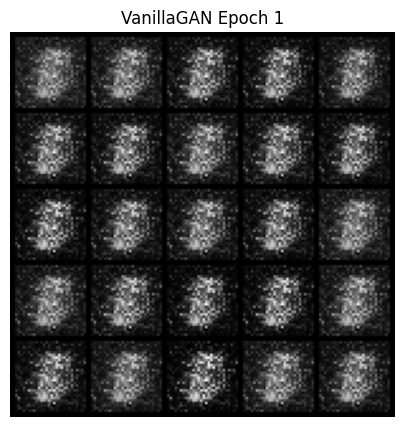

[VanillaGAN] Epoch [2/25]  D_loss: 0.4719  G_loss: 1.4876


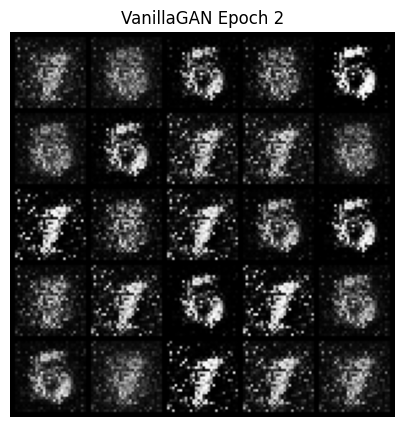

[VanillaGAN] Epoch [3/25]  D_loss: 0.8617  G_loss: 0.8972


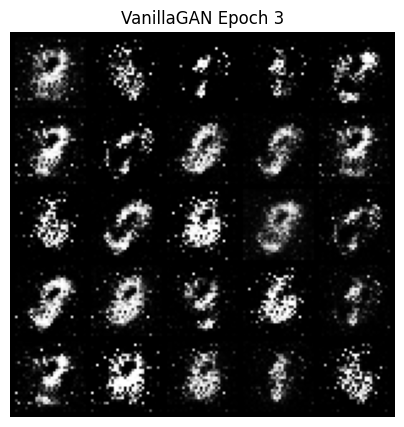

[VanillaGAN] Epoch [4/25]  D_loss: 0.7188  G_loss: 2.9940


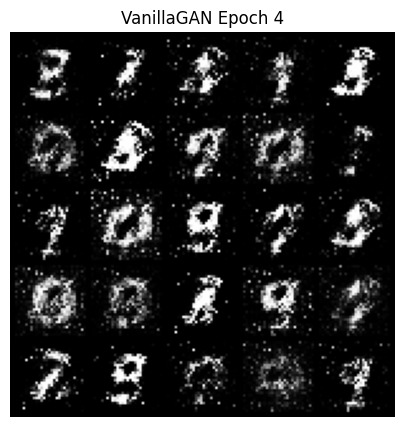

[VanillaGAN] Epoch [5/25]  D_loss: 0.5609  G_loss: 1.6672


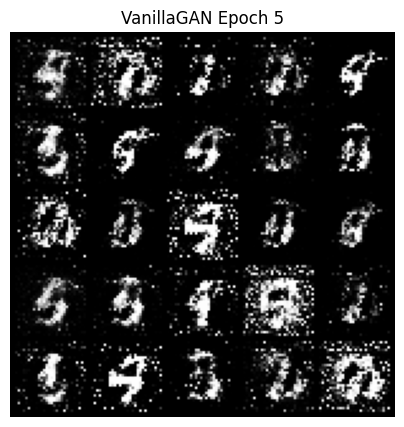

[VanillaGAN] Epoch [6/25]  D_loss: 0.4063  G_loss: 2.0043


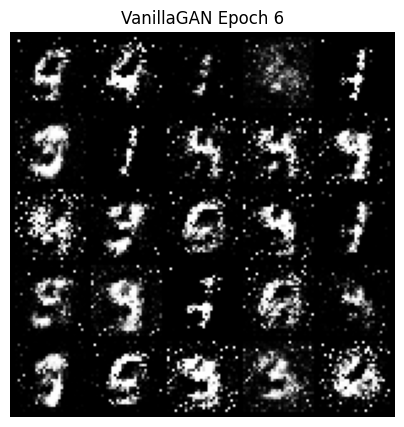

[VanillaGAN] Epoch [7/25]  D_loss: 0.6625  G_loss: 1.7404


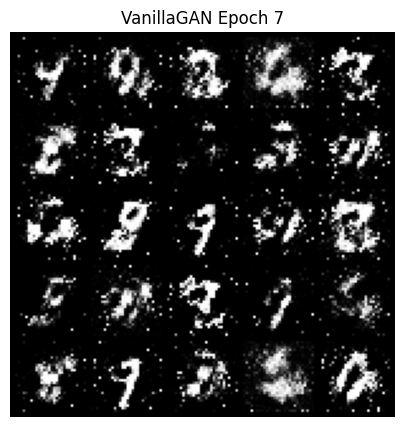

[VanillaGAN] Epoch [8/25]  D_loss: 0.8148  G_loss: 1.0386


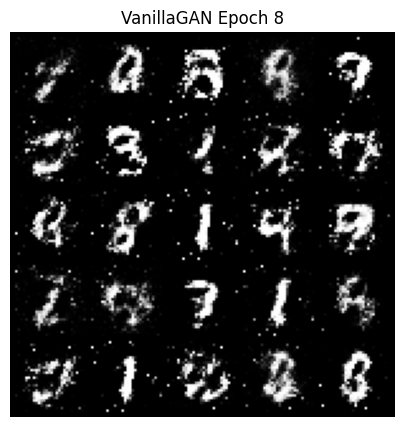

[VanillaGAN] Epoch [9/25]  D_loss: 0.9039  G_loss: 1.2838


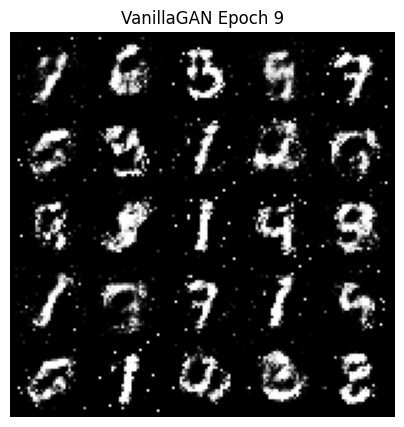

[VanillaGAN] Epoch [10/25]  D_loss: 0.9944  G_loss: 1.2367


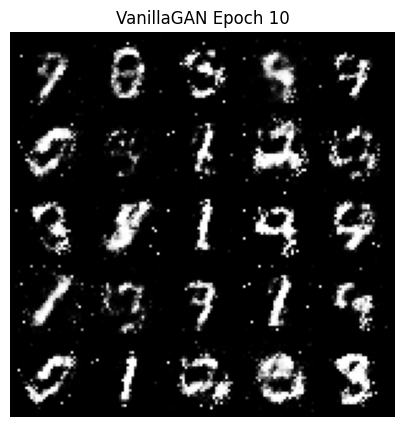

[VanillaGAN] Epoch [11/25]  D_loss: 1.1266  G_loss: 0.9817


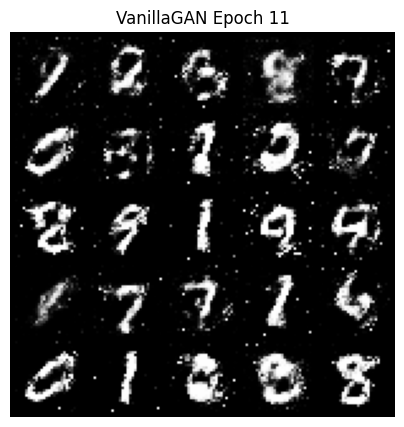

[VanillaGAN] Epoch [12/25]  D_loss: 1.2077  G_loss: 0.9959


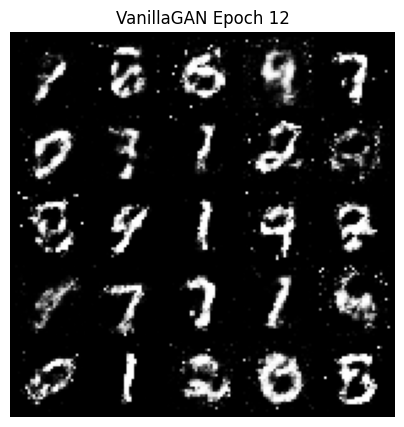

[VanillaGAN] Epoch [13/25]  D_loss: 1.3058  G_loss: 1.7335


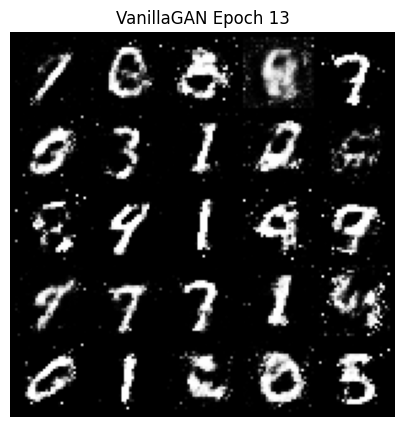

[VanillaGAN] Epoch [14/25]  D_loss: 1.1570  G_loss: 0.7875


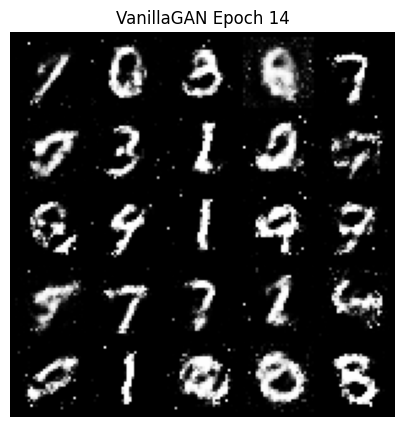

[VanillaGAN] Epoch [15/25]  D_loss: 1.1647  G_loss: 0.8560


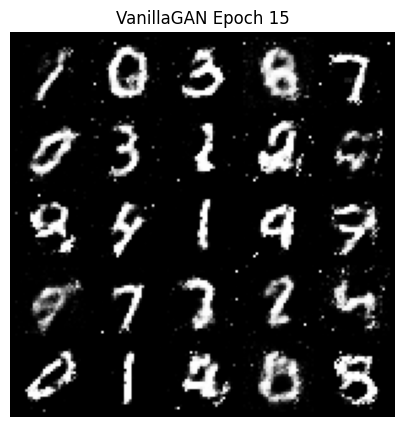

[VanillaGAN] Epoch [16/25]  D_loss: 1.2740  G_loss: 1.4393


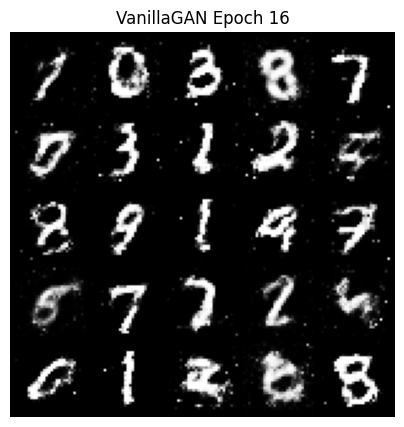

[VanillaGAN] Epoch [17/25]  D_loss: 1.1219  G_loss: 1.0358


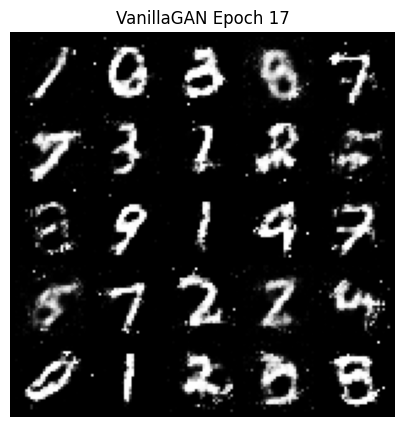

[VanillaGAN] Epoch [18/25]  D_loss: 1.1213  G_loss: 1.0045


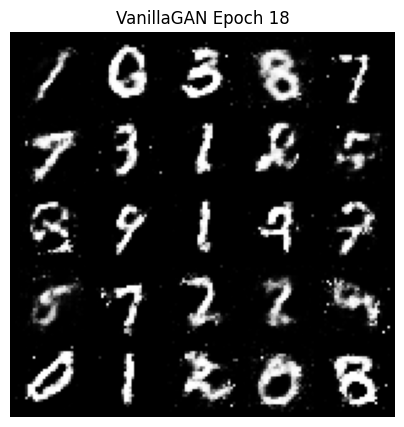

[VanillaGAN] Epoch [19/25]  D_loss: 1.1138  G_loss: 1.0257


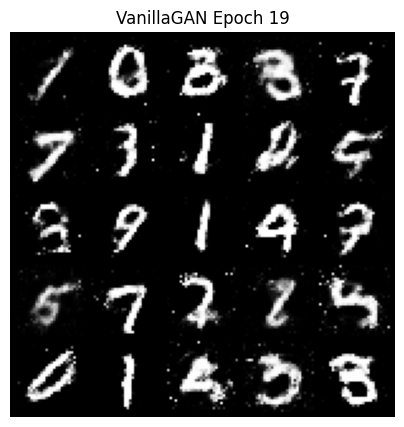

[VanillaGAN] Epoch [20/25]  D_loss: 1.1444  G_loss: 1.0111


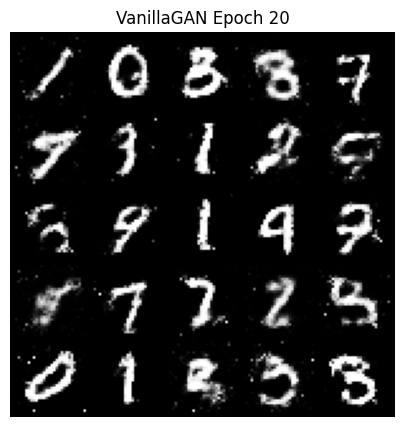

[VanillaGAN] Epoch [21/25]  D_loss: 1.2048  G_loss: 1.1120


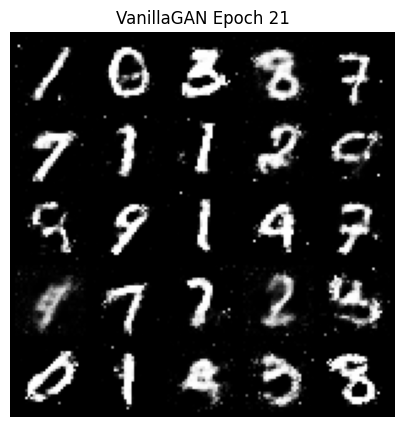

[VanillaGAN] Epoch [22/25]  D_loss: 1.2231  G_loss: 0.6248


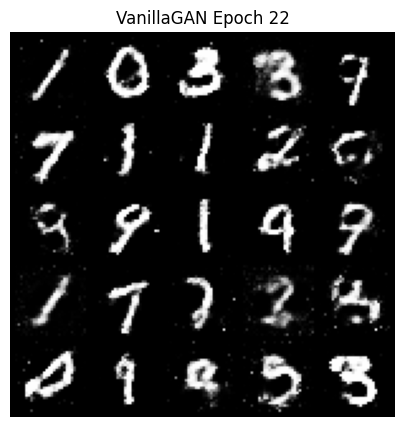

[VanillaGAN] Epoch [23/25]  D_loss: 1.2329  G_loss: 1.1062


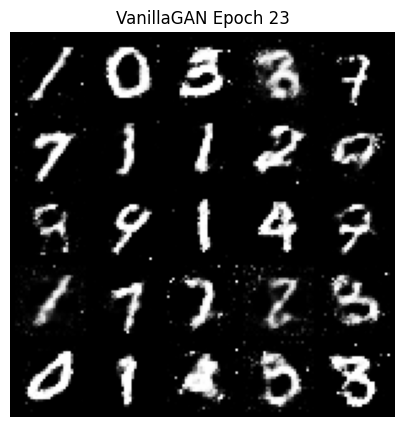

[VanillaGAN] Epoch [24/25]  D_loss: 1.1489  G_loss: 0.8969


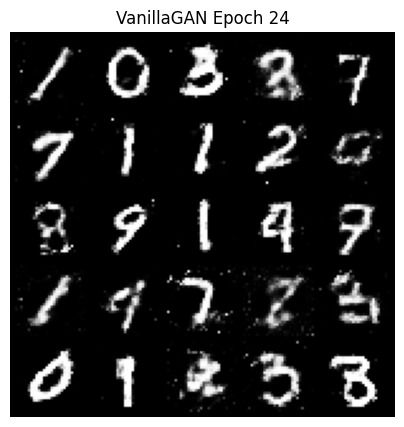

[VanillaGAN] Epoch [25/25]  D_loss: 0.9859  G_loss: 1.0179


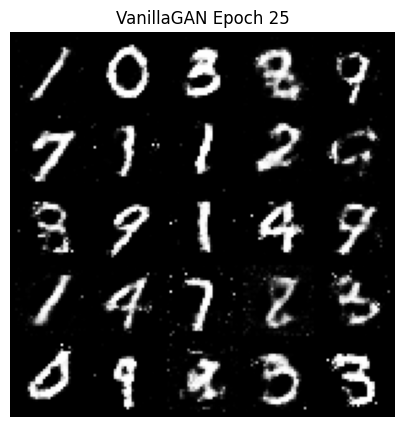

In [ ]:
# 1. Vanilla GAN
print("\n========== Training Vanilla GAN ==========\n")
van_g_losses, van_d_losses = train_vanilla_GAN()


========== Training DCGAN ==========

[DCGAN] Epoch [1/25]  D_loss: 0.8482  G_loss: 1.6649


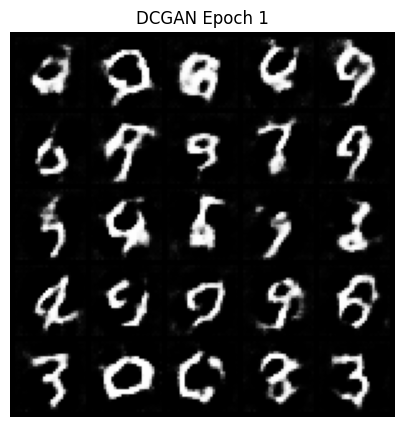

[DCGAN] Epoch [2/25]  D_loss: 0.9347  G_loss: 1.4363


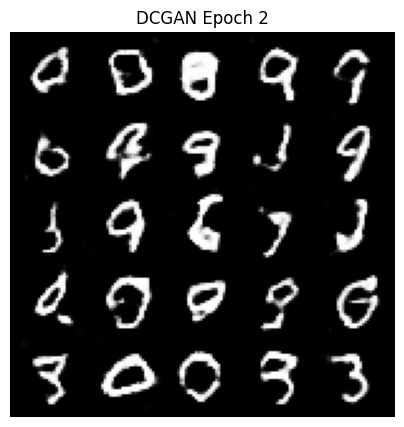

[DCGAN] Epoch [3/25]  D_loss: 0.7715  G_loss: 1.4973


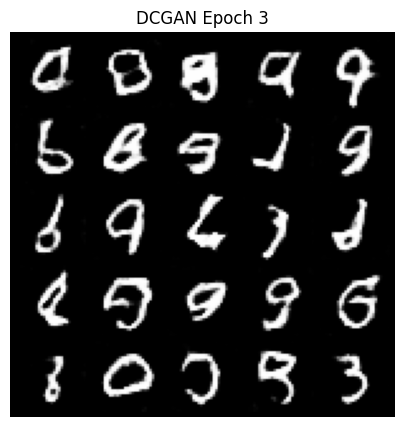

[DCGAN] Epoch [4/25]  D_loss: 1.0947  G_loss: 1.1017


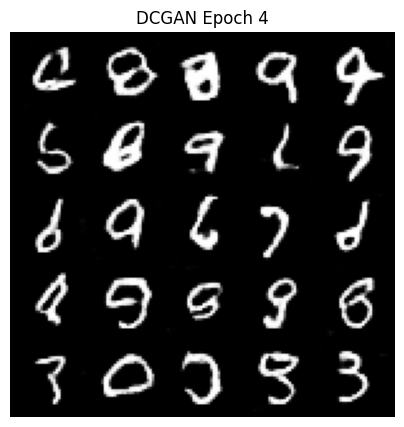

[DCGAN] Epoch [5/25]  D_loss: 0.8331  G_loss: 1.1757


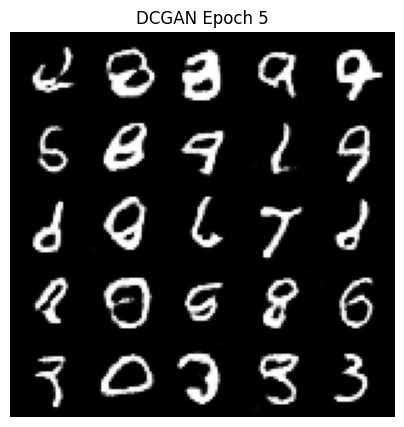

[DCGAN] Epoch [6/25]  D_loss: 1.1045  G_loss: 0.6955


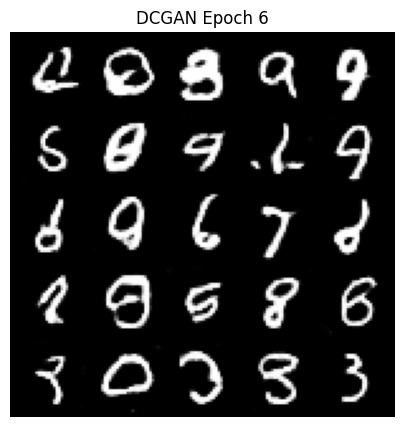

[DCGAN] Epoch [7/25]  D_loss: 1.1162  G_loss: 0.6709


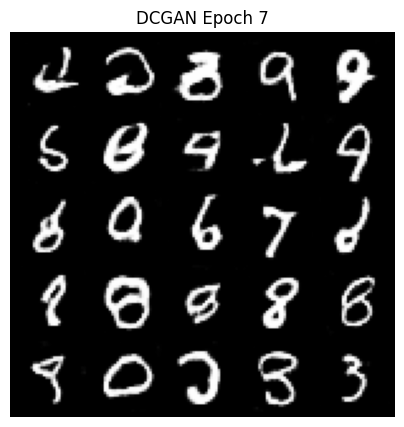

[DCGAN] Epoch [8/25]  D_loss: 1.0599  G_loss: 0.8295


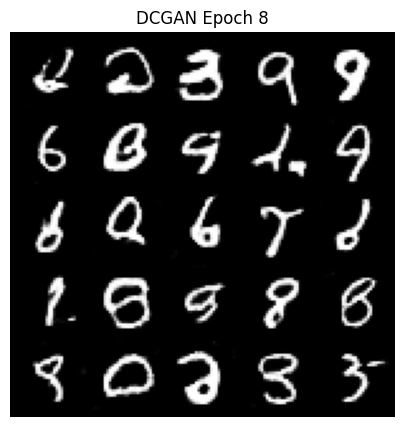

[DCGAN] Epoch [9/25]  D_loss: 1.0557  G_loss: 0.7515


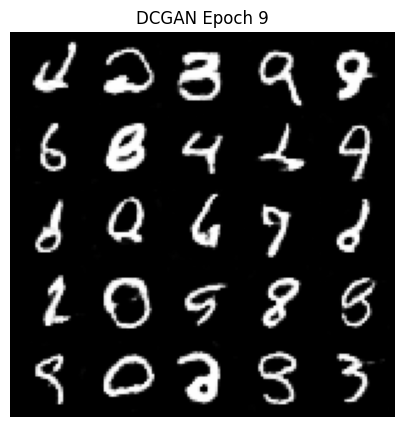

[DCGAN] Epoch [10/25]  D_loss: 0.8848  G_loss: 1.8355


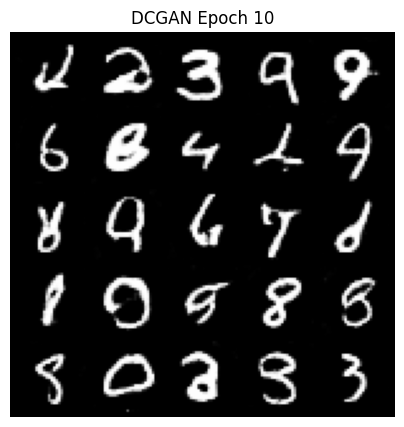

[DCGAN] Epoch [11/25]  D_loss: 0.9285  G_loss: 1.3562


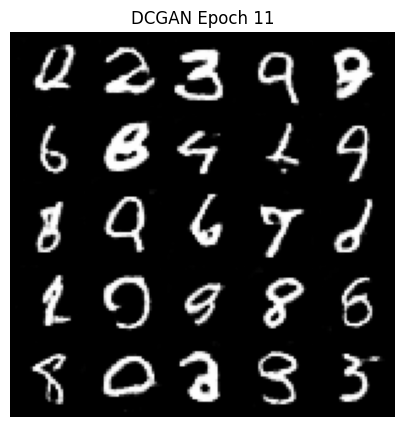

[DCGAN] Epoch [12/25]  D_loss: 1.1527  G_loss: 1.8282


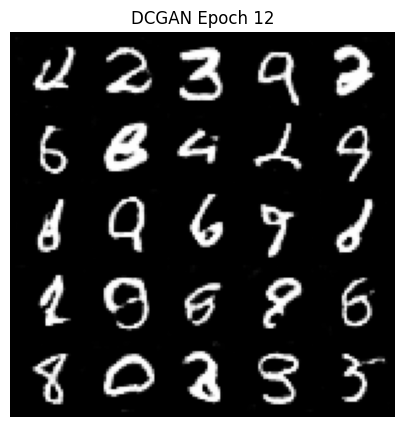

[DCGAN] Epoch [13/25]  D_loss: 1.0261  G_loss: 0.8967


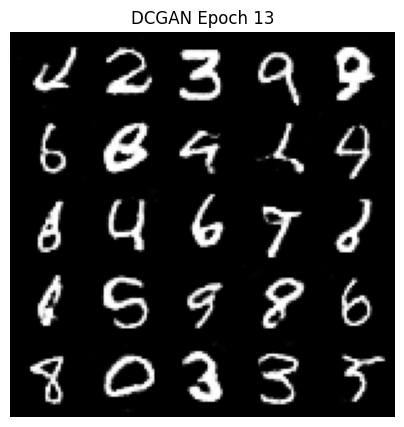

[DCGAN] Epoch [14/25]  D_loss: 1.1216  G_loss: 1.3302


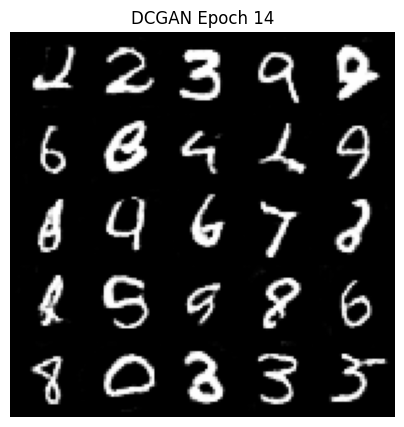

[DCGAN] Epoch [15/25]  D_loss: 0.8751  G_loss: 1.0292


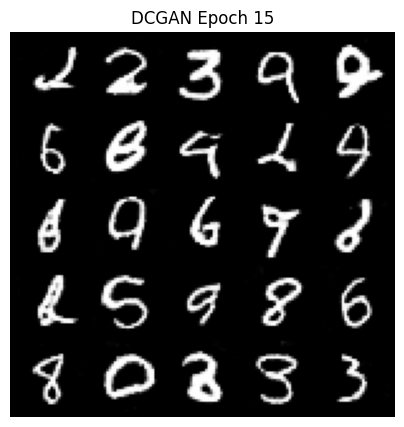

[DCGAN] Epoch [16/25]  D_loss: 1.3010  G_loss: 0.6022


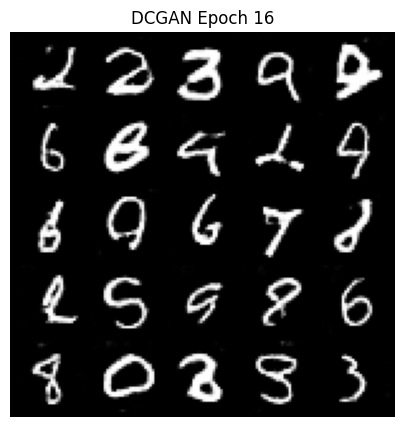

[DCGAN] Epoch [17/25]  D_loss: 1.0716  G_loss: 1.2248


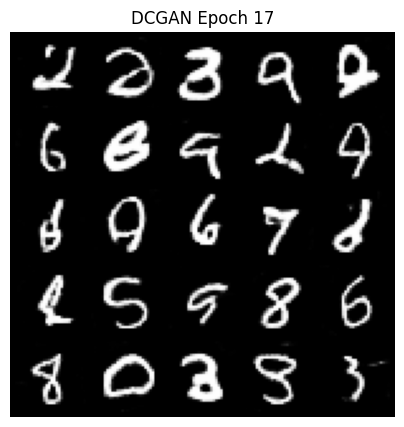

[DCGAN] Epoch [18/25]  D_loss: 0.9510  G_loss: 1.2438


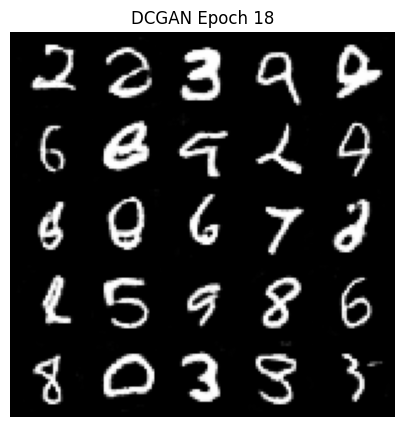

[DCGAN] Epoch [19/25]  D_loss: 0.9704  G_loss: 0.8291


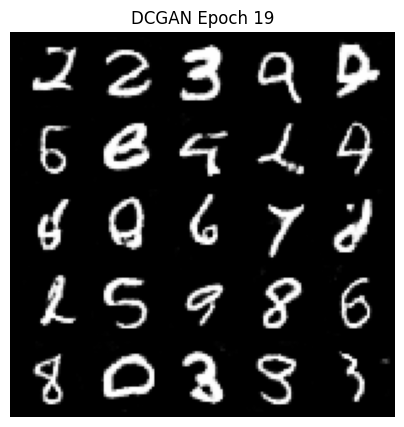

[DCGAN] Epoch [20/25]  D_loss: 1.1812  G_loss: 0.6288


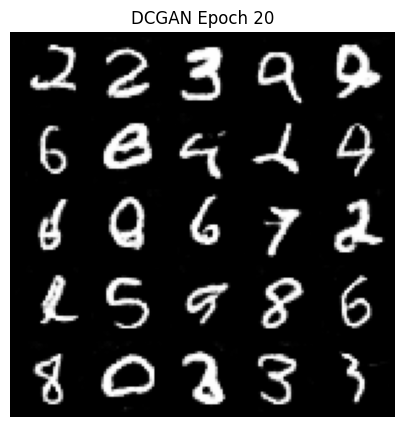

[DCGAN] Epoch [21/25]  D_loss: 1.1505  G_loss: 1.0873


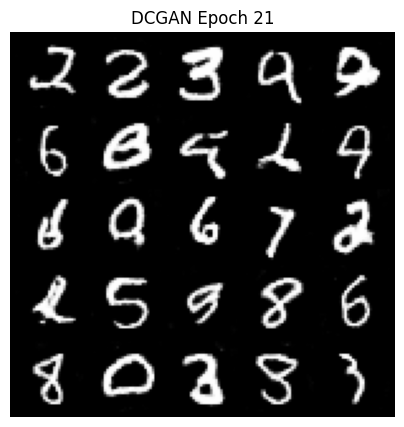

[DCGAN] Epoch [22/25]  D_loss: 1.2267  G_loss: 1.6096


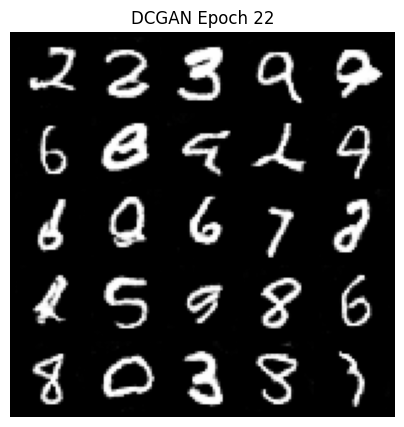

[DCGAN] Epoch [23/25]  D_loss: 0.9932  G_loss: 1.2234


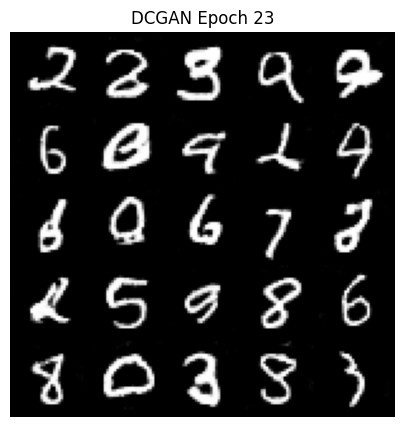

[DCGAN] Epoch [24/25]  D_loss: 0.9490  G_loss: 2.2392


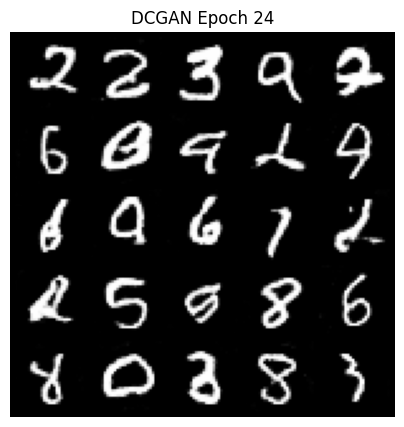

[DCGAN] Epoch [25/25]  D_loss: 1.1204  G_loss: 0.8295


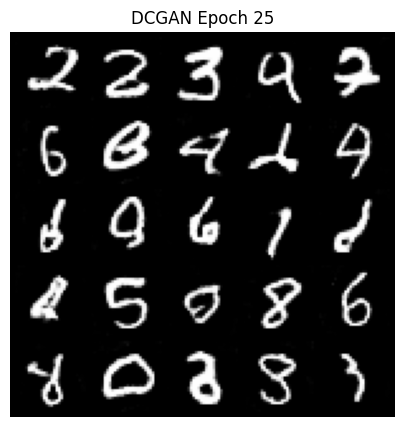

In [ ]:
# 2. DCGAN
print("\n========== Training DCGAN ==========\n")
dcgan_g_losses, dcgan_d_losses = train_DCGAN()


========== Training WGAN ==========

[WGAN] Epoch [1/25]  D_loss: -0.1032  G_loss: -2.0270


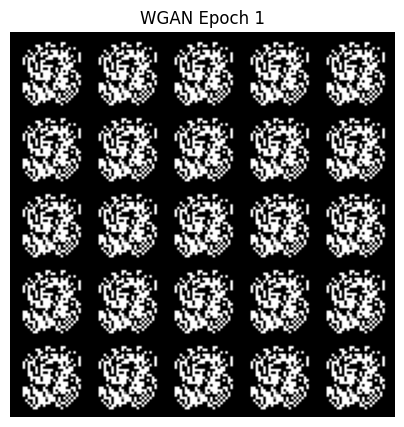

[WGAN] Epoch [2/25]  D_loss: -1.5443  G_loss: -8.7578


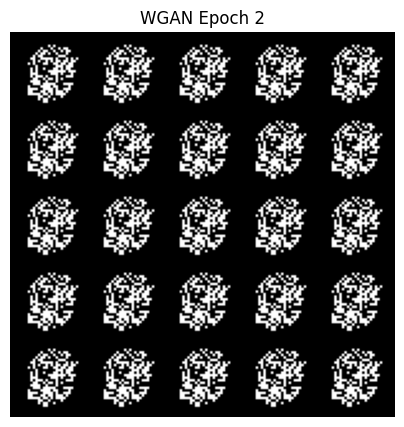

[WGAN] Epoch [3/25]  D_loss: -9.6925  G_loss: -13.3981


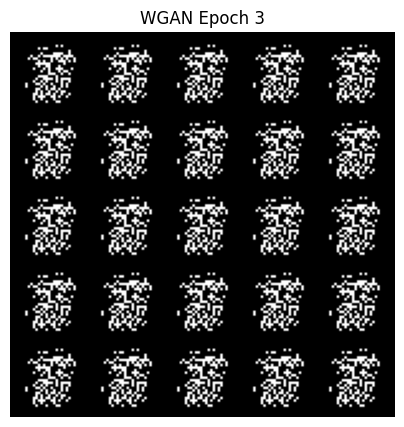

[WGAN] Epoch [4/25]  D_loss: -11.0979  G_loss: -16.0989


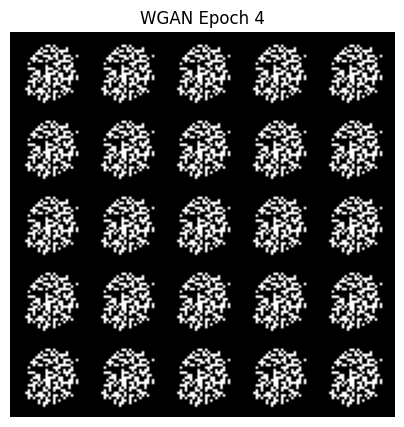

[WGAN] Epoch [5/25]  D_loss: -11.5753  G_loss: -16.5016


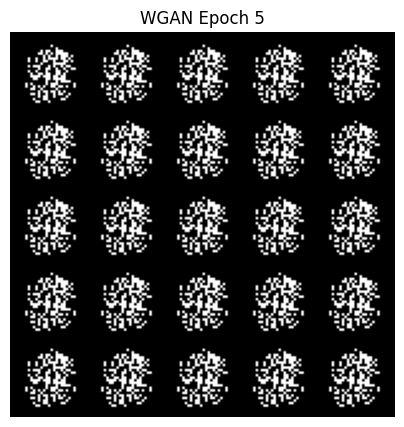

[WGAN] Epoch [6/25]  D_loss: -15.2667  G_loss: -19.5249


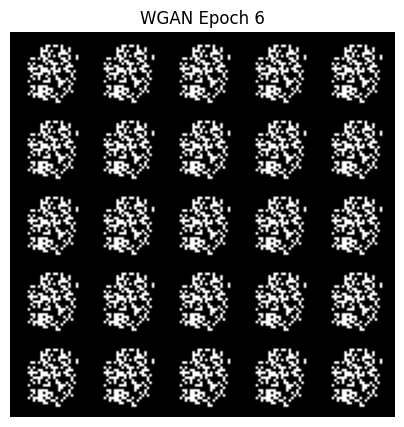

[WGAN] Epoch [7/25]  D_loss: -15.9896  G_loss: -22.3274


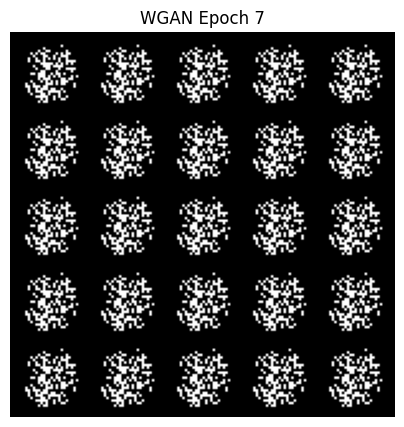

[WGAN] Epoch [8/25]  D_loss: -17.8341  G_loss: -22.9289


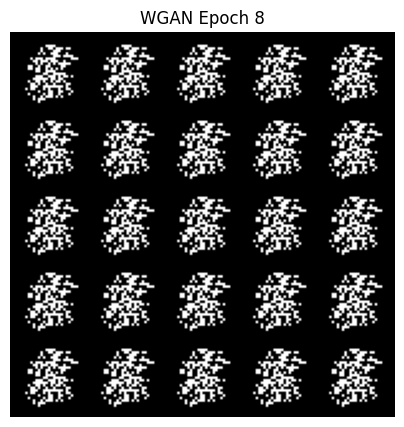

[WGAN] Epoch [9/25]  D_loss: -15.8008  G_loss: -23.4435


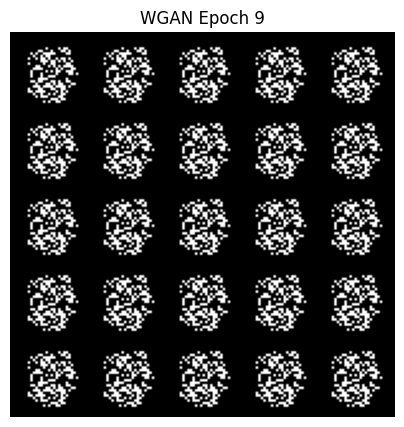

[WGAN] Epoch [10/25]  D_loss: -16.6732  G_loss: -23.4458


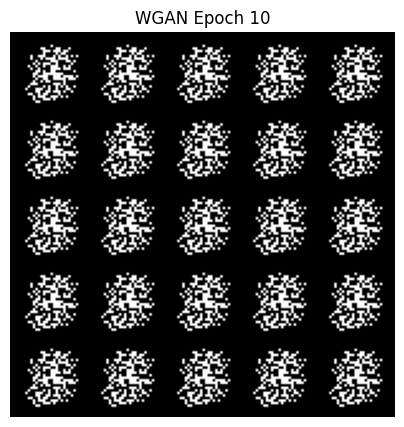

[WGAN] Epoch [11/25]  D_loss: -19.4702  G_loss: -23.7619


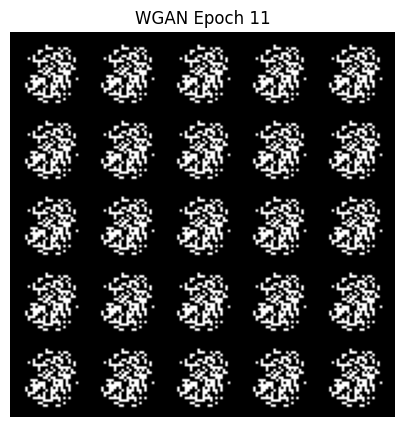

[WGAN] Epoch [12/25]  D_loss: -19.3285  G_loss: -22.2643


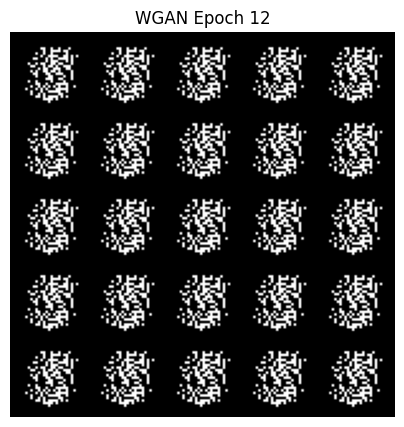

[WGAN] Epoch [13/25]  D_loss: -21.6051  G_loss: -25.5958


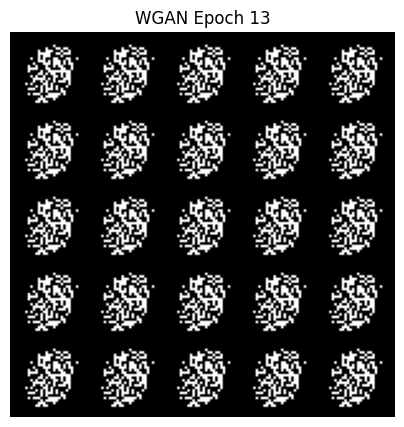

[WGAN] Epoch [14/25]  D_loss: -17.7241  G_loss: -24.8292


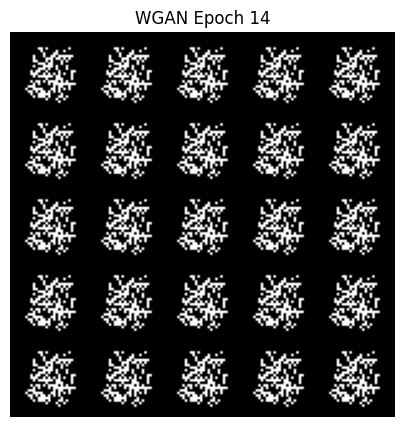

[WGAN] Epoch [15/25]  D_loss: -20.3871  G_loss: -28.3069


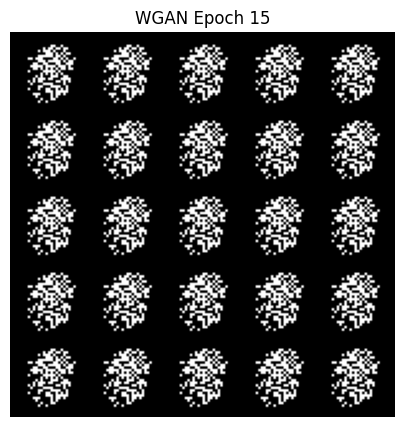

[WGAN] Epoch [16/25]  D_loss: -18.8269  G_loss: -25.9991


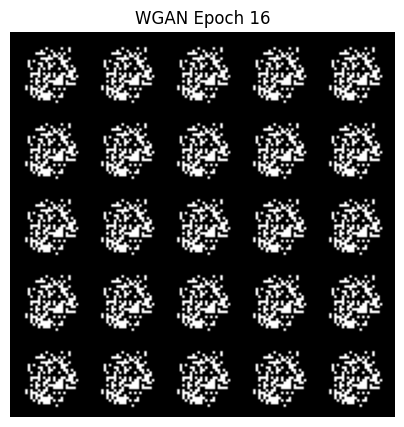

[WGAN] Epoch [17/25]  D_loss: -18.0940  G_loss: -25.1194


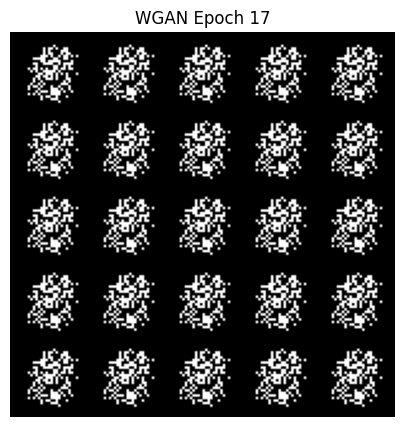

[WGAN] Epoch [18/25]  D_loss: -21.1433  G_loss: -26.0413


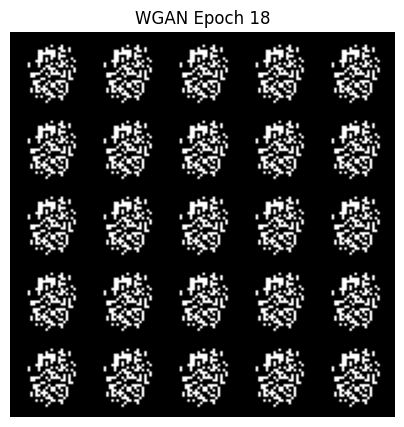

[WGAN] Epoch [19/25]  D_loss: -17.8860  G_loss: -23.9230


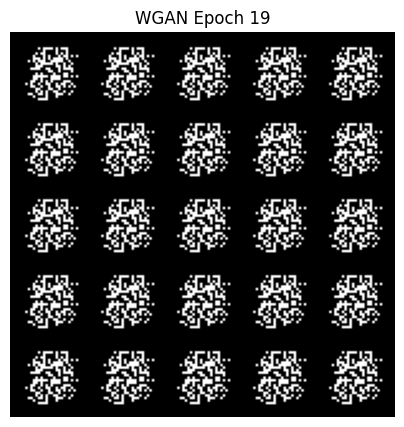

[WGAN] Epoch [20/25]  D_loss: -20.2177  G_loss: -27.0668


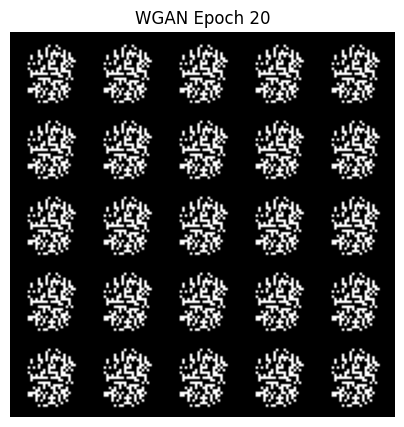

[WGAN] Epoch [21/25]  D_loss: -16.7349  G_loss: -23.2750


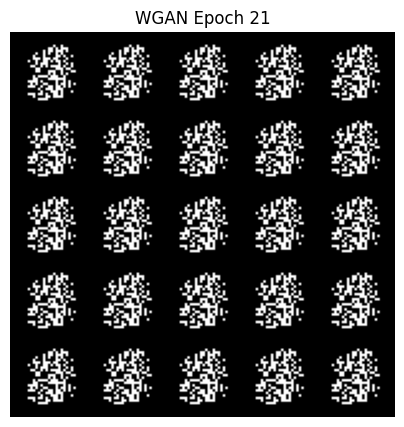

[WGAN] Epoch [22/25]  D_loss: -19.6508  G_loss: -24.6811


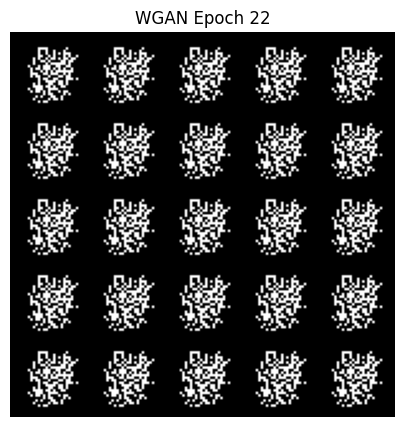

[WGAN] Epoch [23/25]  D_loss: -24.2435  G_loss: -27.5696


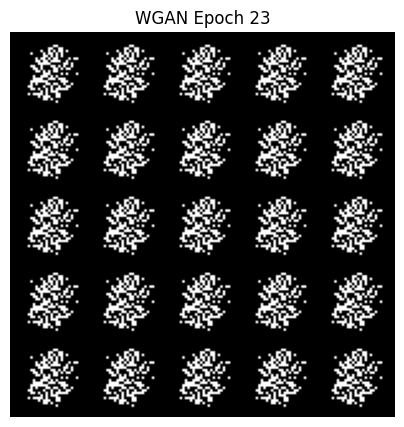

[WGAN] Epoch [24/25]  D_loss: -18.5654  G_loss: -24.4876


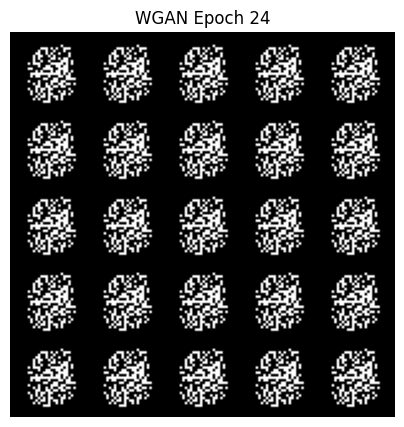

[WGAN] Epoch [25/25]  D_loss: -16.4226  G_loss: -22.4065


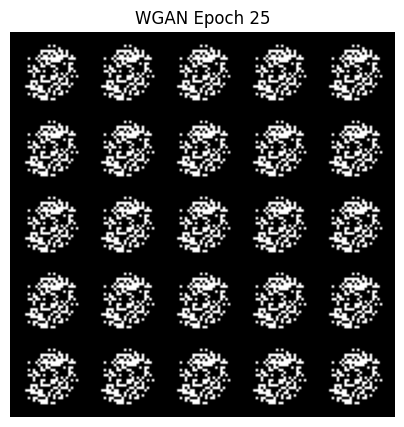

In [ ]:
# 3. WGAN
print("\n========== Training WGAN ==========\n")
wgan_g_losses, wgan_d_losses = train_WGAN(weight_clipping_limit=0.01)


========== Training WGAN-GP ==========

[WGAN-GP] Epoch [1/25]  D_loss: -8.7873  G_loss: -25.8326


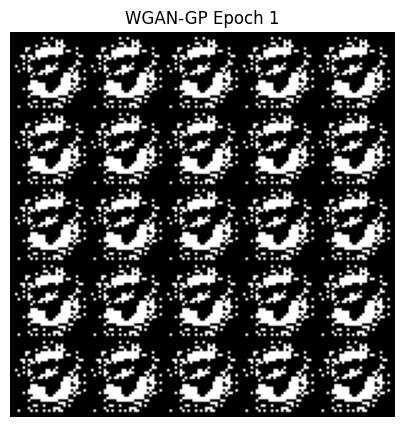

[WGAN-GP] Epoch [2/25]  D_loss: -8.5180  G_loss: -29.2161


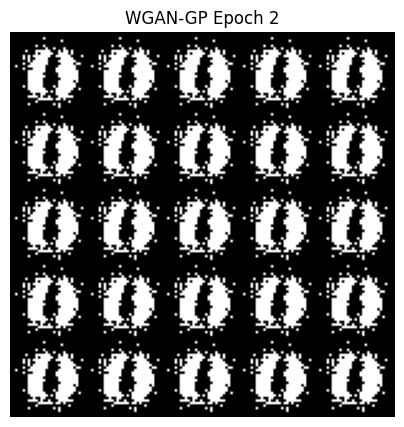

[WGAN-GP] Epoch [3/25]  D_loss: -10.1221  G_loss: -31.0573


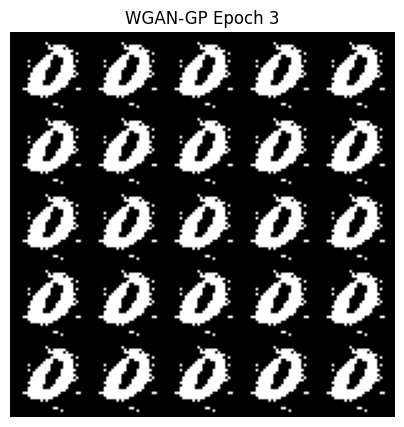

[WGAN-GP] Epoch [4/25]  D_loss: -6.7117  G_loss: -24.1638


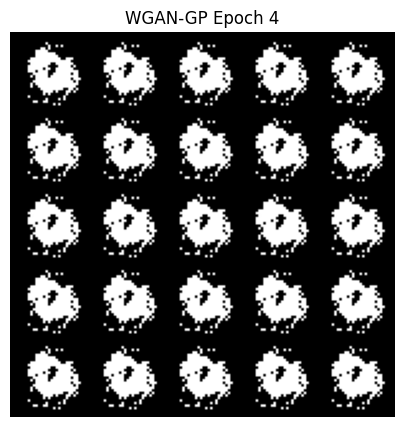

[WGAN-GP] Epoch [5/25]  D_loss: -6.5581  G_loss: -17.9657


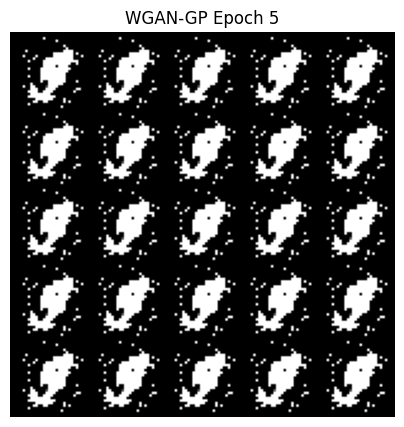

[WGAN-GP] Epoch [6/25]  D_loss: -9.7317  G_loss: -18.1090


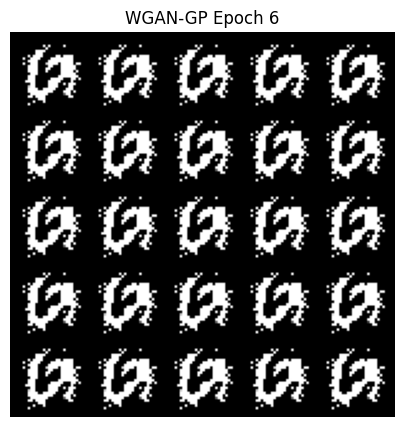

[WGAN-GP] Epoch [7/25]  D_loss: -10.9504  G_loss: -17.7713


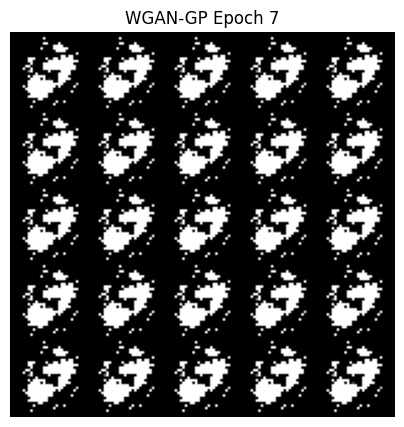

[WGAN-GP] Epoch [8/25]  D_loss: -11.5224  G_loss: -19.4830


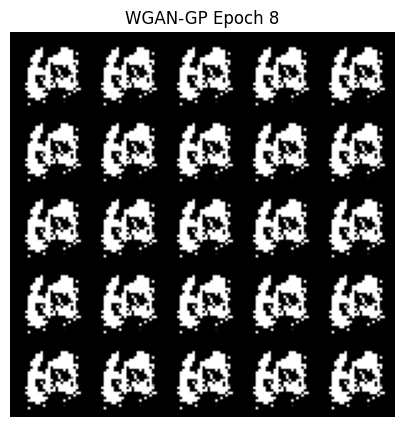

[WGAN-GP] Epoch [9/25]  D_loss: -10.5974  G_loss: -20.0597


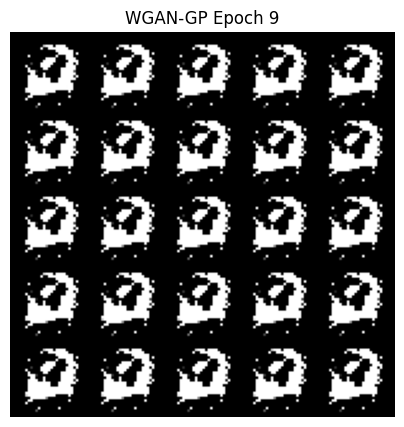

[WGAN-GP] Epoch [10/25]  D_loss: -9.9437  G_loss: -23.2178


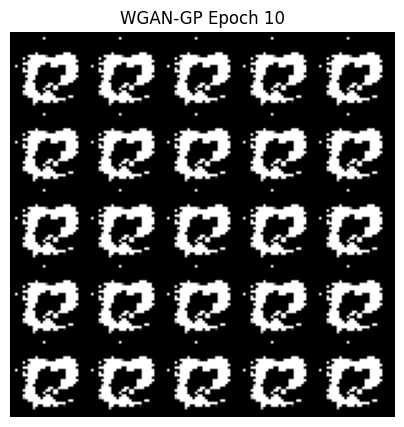

[WGAN-GP] Epoch [11/25]  D_loss: -9.9098  G_loss: -21.8409


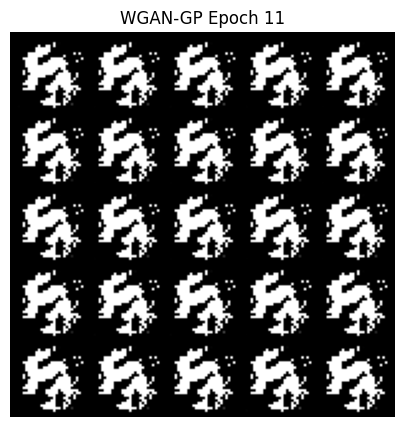

[WGAN-GP] Epoch [12/25]  D_loss: -8.9649  G_loss: -22.2010


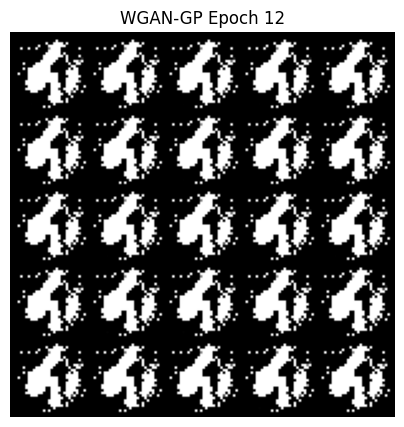

[WGAN-GP] Epoch [13/25]  D_loss: -7.7613  G_loss: -22.5438


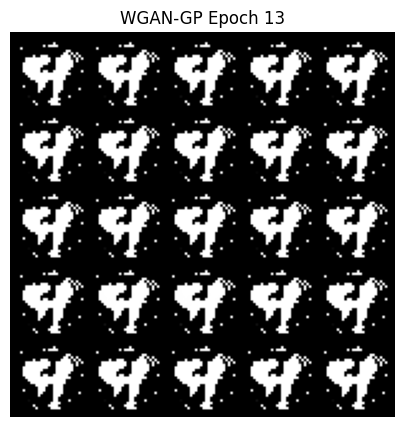

[WGAN-GP] Epoch [14/25]  D_loss: -7.5317  G_loss: -23.4449


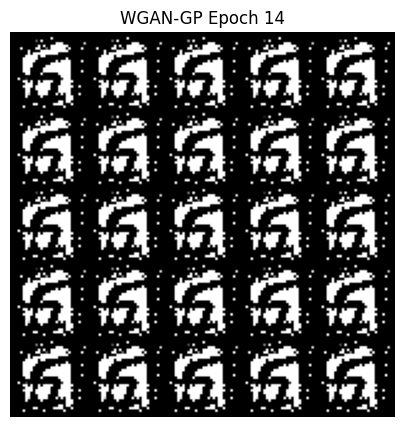

[WGAN-GP] Epoch [15/25]  D_loss: -7.5804  G_loss: -22.9874


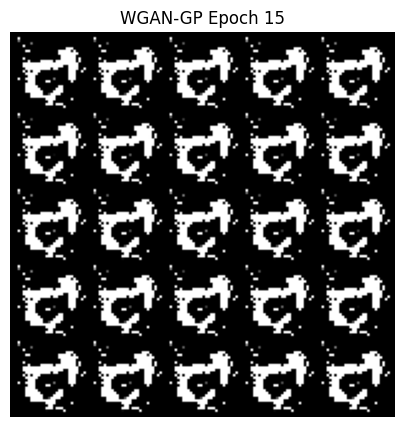

[WGAN-GP] Epoch [16/25]  D_loss: -11.4406  G_loss: -17.9670


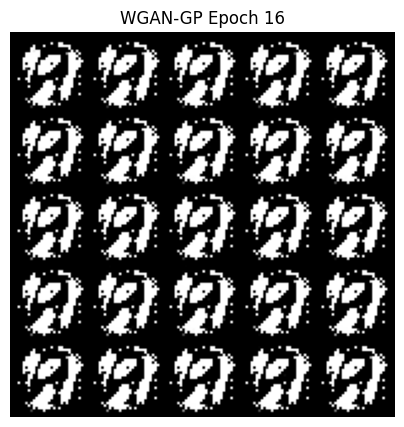

[WGAN-GP] Epoch [17/25]  D_loss: -7.3911  G_loss: -22.6160


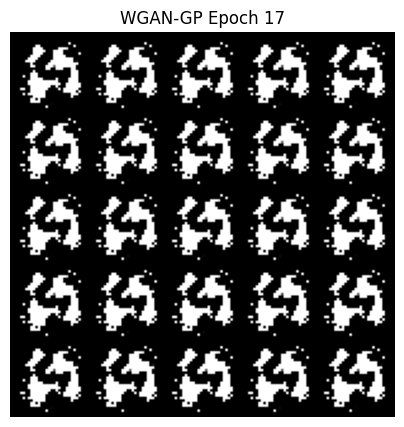

[WGAN-GP] Epoch [18/25]  D_loss: -7.8546  G_loss: -23.1311


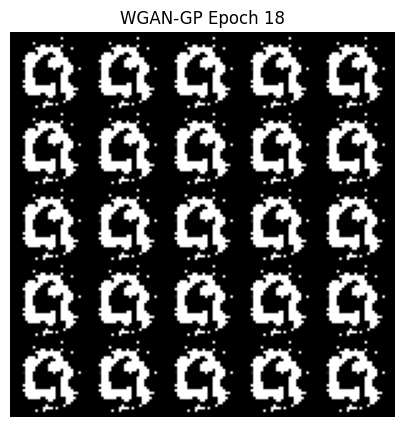

[WGAN-GP] Epoch [19/25]  D_loss: -12.0024  G_loss: -22.2388


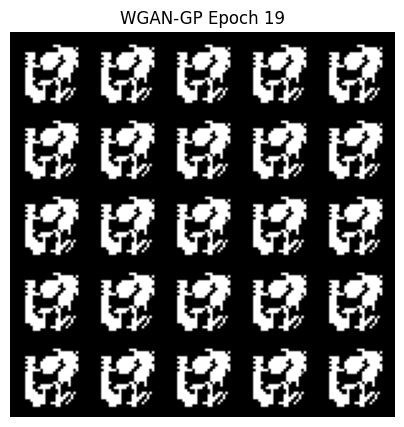

[WGAN-GP] Epoch [20/25]  D_loss: -25.3844  G_loss: 7.7456


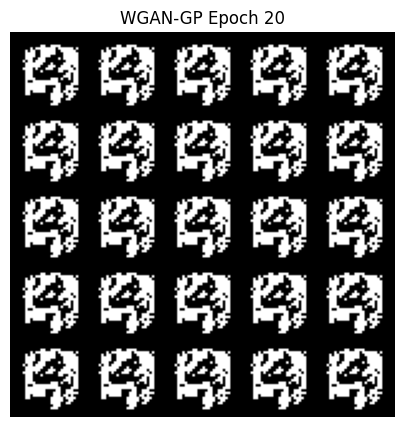

[WGAN-GP] Epoch [21/25]  D_loss: -22.3298  G_loss: -0.9565


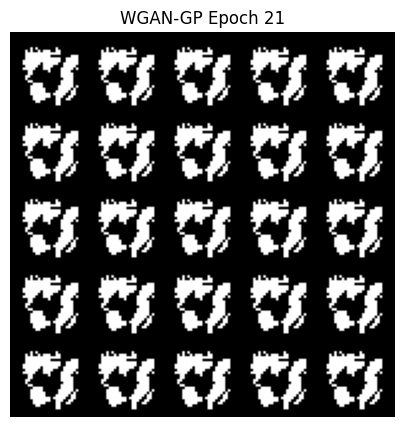

[WGAN-GP] Epoch [22/25]  D_loss: -23.3939  G_loss: -2.7677


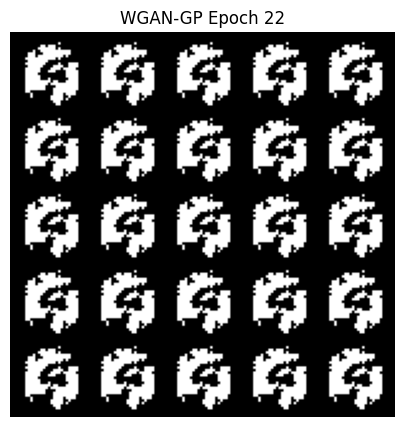

[WGAN-GP] Epoch [23/25]  D_loss: -23.3898  G_loss: 7.4589


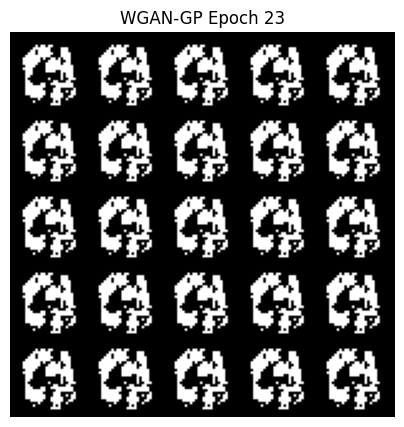

[WGAN-GP] Epoch [24/25]  D_loss: -25.2863  G_loss: -17.6778


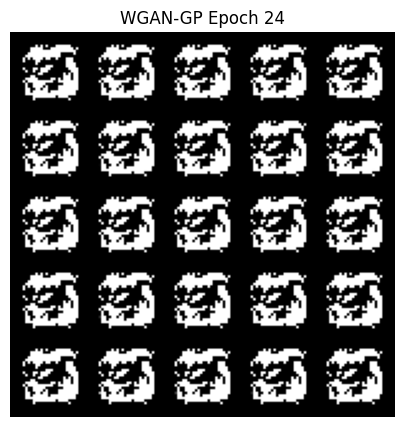

[WGAN-GP] Epoch [25/25]  D_loss: -28.1487  G_loss: -16.3259


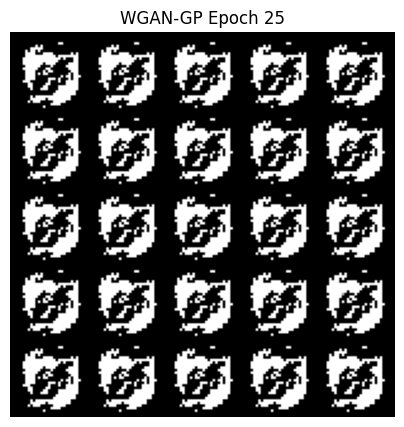

In [ ]:
# 4. WGAN-GP
print("\n========== Training WGAN-GP ==========\n")
wgan_gp_g_losses, wgan_gp_d_losses = train_WGAN_GP(lambda_gp=10)


========== Training LSGAN ==========

[LSGAN] Epoch [1/25]  D_loss: 0.1806  G_loss: 0.4923


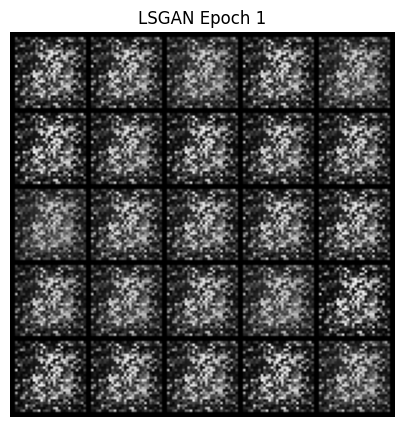

[LSGAN] Epoch [2/25]  D_loss: 0.2208  G_loss: 0.8981


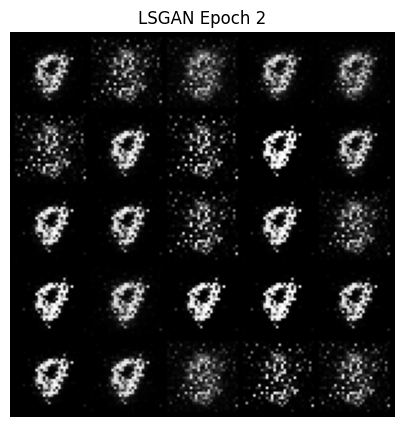

[LSGAN] Epoch [3/25]  D_loss: 0.2560  G_loss: 0.3313


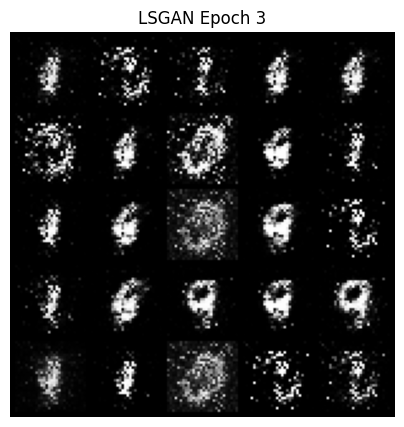

[LSGAN] Epoch [4/25]  D_loss: 0.3929  G_loss: 0.8063


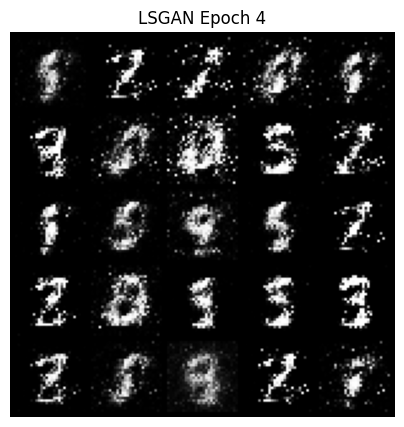

[LSGAN] Epoch [5/25]  D_loss: 0.2221  G_loss: 0.5550


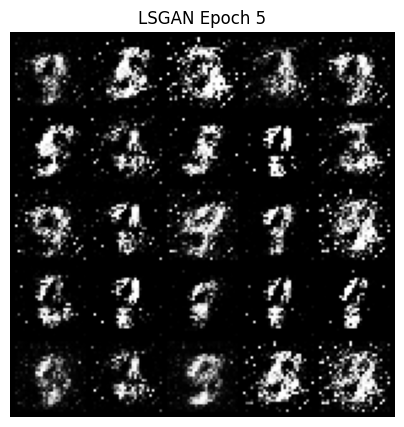

[LSGAN] Epoch [6/25]  D_loss: 0.1970  G_loss: 0.8940


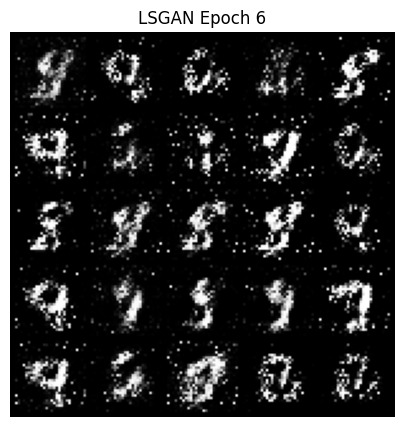

[LSGAN] Epoch [7/25]  D_loss: 0.3204  G_loss: 0.3570


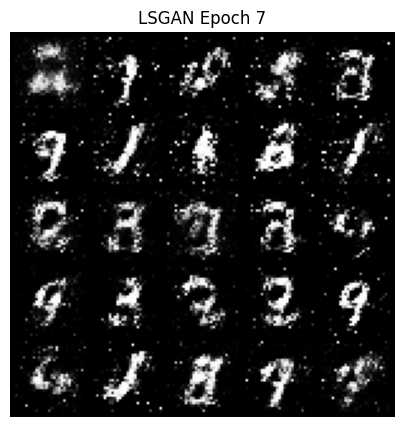

[LSGAN] Epoch [8/25]  D_loss: 0.2501  G_loss: 0.4709


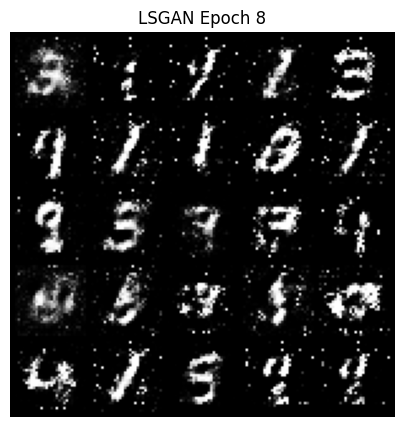

[LSGAN] Epoch [9/25]  D_loss: 0.3337  G_loss: 0.3889


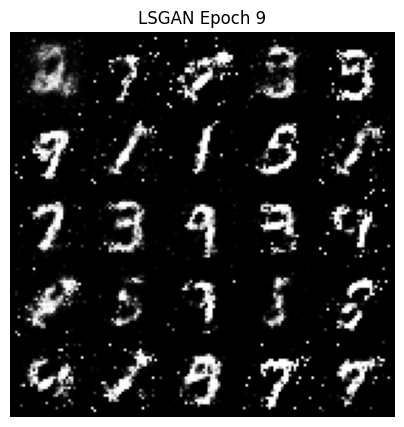

[LSGAN] Epoch [10/25]  D_loss: 0.3856  G_loss: 0.5325


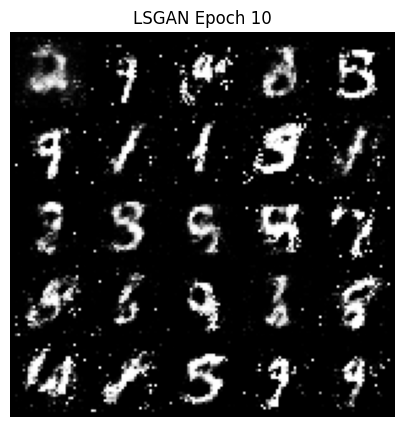

[LSGAN] Epoch [11/25]  D_loss: 0.3921  G_loss: 0.2567


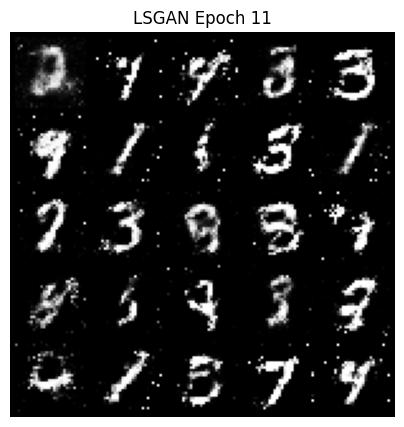

[LSGAN] Epoch [12/25]  D_loss: 0.4716  G_loss: 0.2819


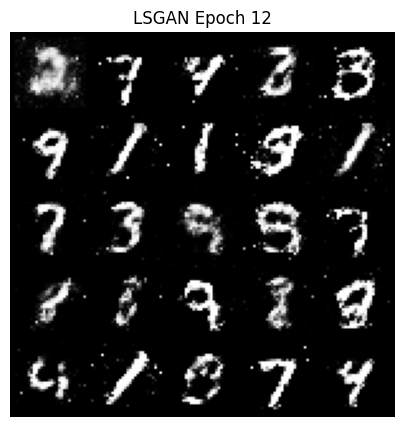

[LSGAN] Epoch [13/25]  D_loss: 0.4423  G_loss: 0.3497


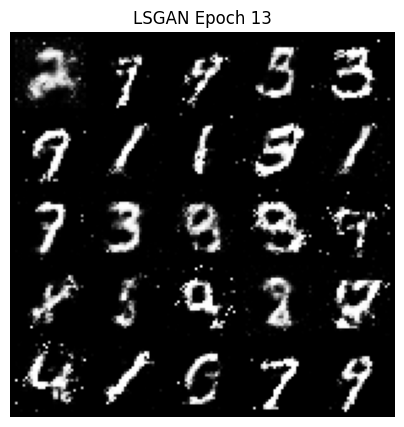

[LSGAN] Epoch [14/25]  D_loss: 0.4234  G_loss: 0.2898


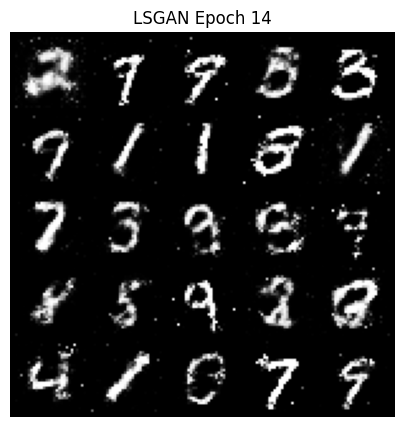

[LSGAN] Epoch [15/25]  D_loss: 0.3724  G_loss: 0.4471


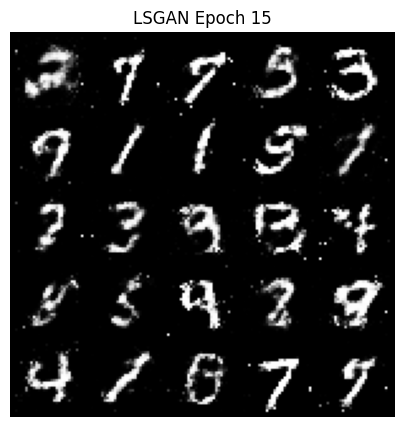

[LSGAN] Epoch [16/25]  D_loss: 0.3628  G_loss: 0.3776


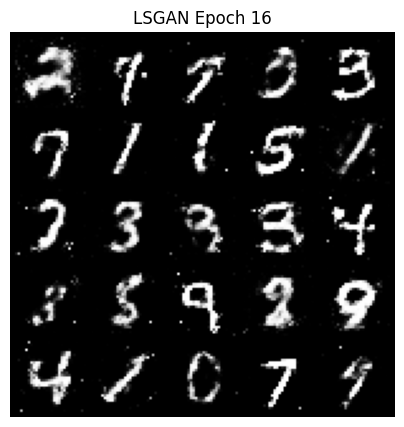

[LSGAN] Epoch [17/25]  D_loss: 0.3808  G_loss: 0.3711


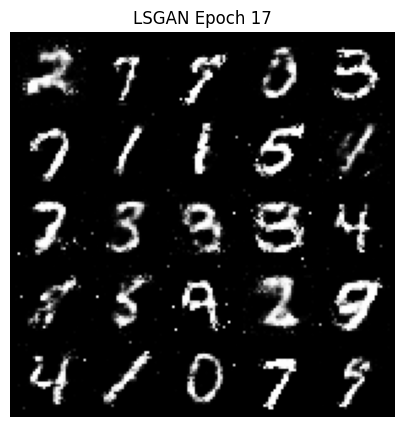

[LSGAN] Epoch [18/25]  D_loss: 0.4069  G_loss: 0.2620


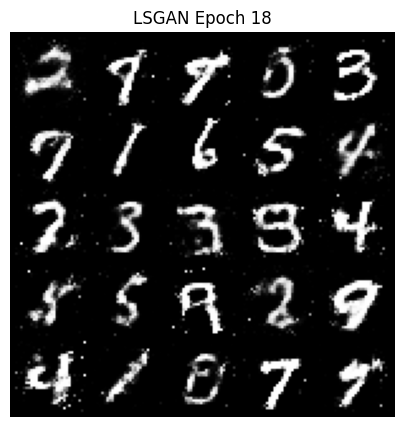

[LSGAN] Epoch [19/25]  D_loss: 0.3714  G_loss: 0.4783


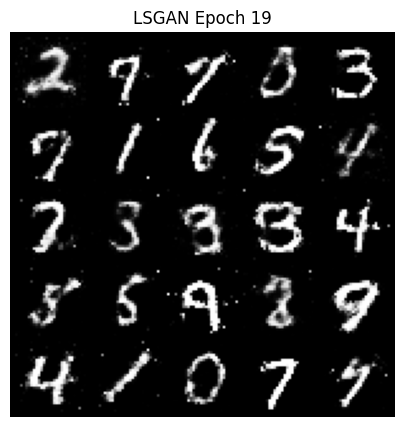

[LSGAN] Epoch [20/25]  D_loss: 0.4717  G_loss: 0.3769


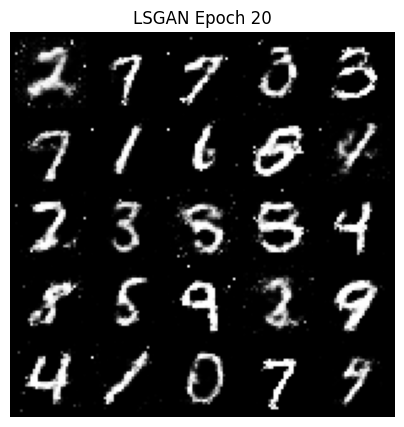

[LSGAN] Epoch [21/25]  D_loss: 0.3653  G_loss: 0.3364


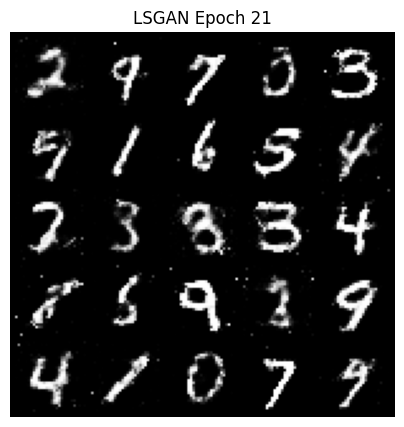

[LSGAN] Epoch [22/25]  D_loss: 0.3919  G_loss: 0.4843


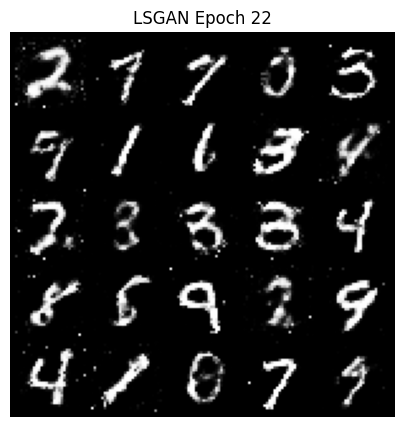

[LSGAN] Epoch [23/25]  D_loss: 0.5001  G_loss: 0.1449


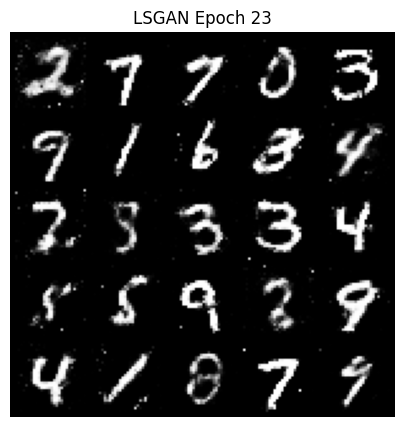

[LSGAN] Epoch [24/25]  D_loss: 0.5030  G_loss: 0.1666


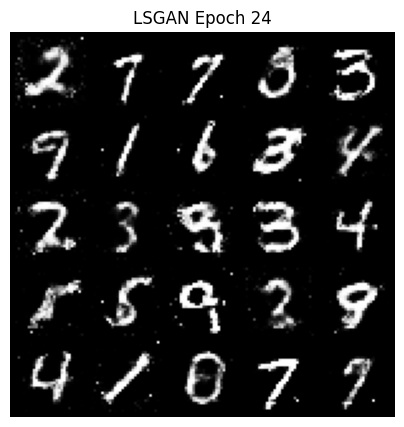

[LSGAN] Epoch [25/25]  D_loss: 0.3962  G_loss: 0.2237


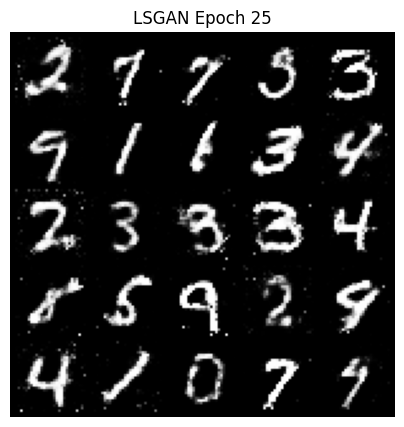

In [ ]:
# 5. LSGAN
print("\n========== Training LSGAN ==========\n")
lsgan_g_losses, lsgan_d_losses = train_LSGAN()

In [ ]:
print("\nTraining Complete!\n")


Training Complete!



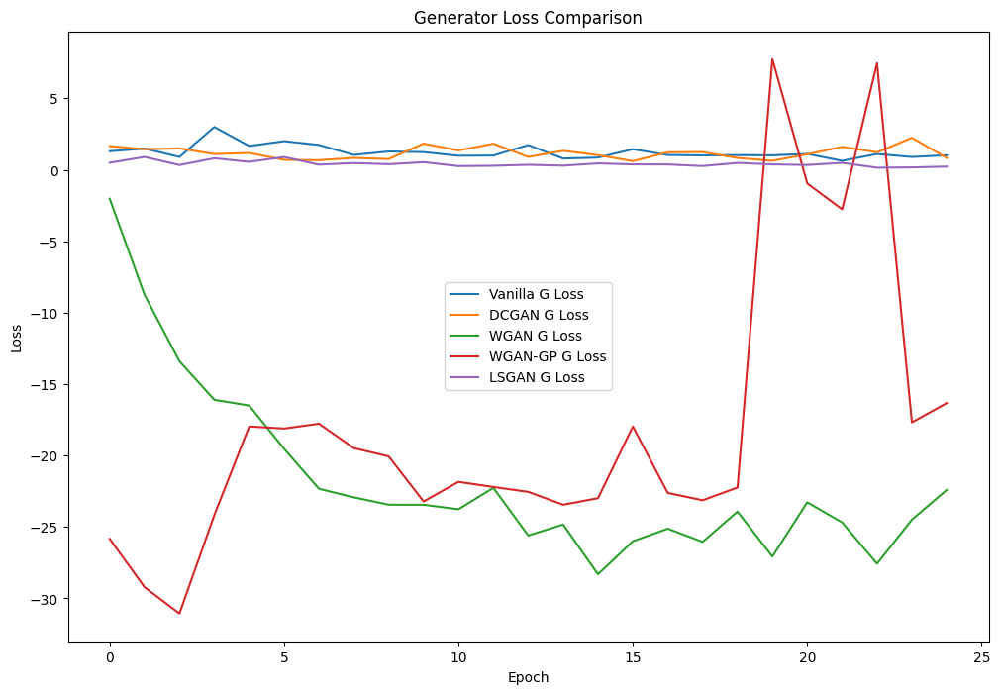

In [ ]:
plt.figure(figsize=(12,8))
plt.plot(van_g_losses, label="Vanilla G Loss")
plt.plot(dcgan_g_losses, label="DCGAN G Loss")
plt.plot(wgan_g_losses, label="WGAN G Loss")
plt.plot(wgan_gp_g_losses, label="WGAN-GP G Loss")
plt.plot(lsgan_g_losses, label="LSGAN G Loss")
plt.title("Generator Loss Comparison")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.show()


In [ ]:
num_epochs=50



========== Training WGAN ==========

[WGAN] Epoch [1/50]  D_loss: -0.0524  G_loss: -2.2289


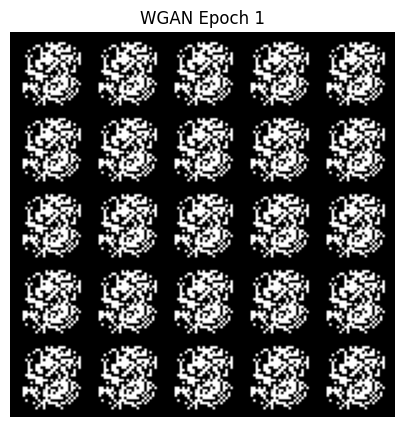

[WGAN] Epoch [2/50]  D_loss: -3.4216  G_loss: -9.7373


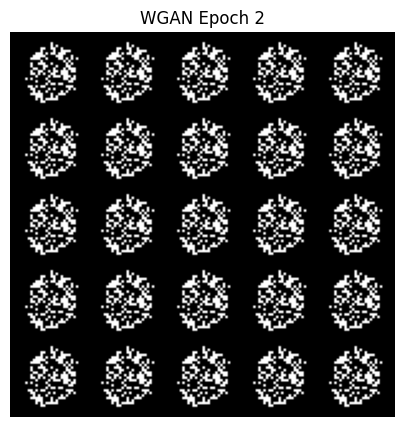

[WGAN] Epoch [3/50]  D_loss: -6.6819  G_loss: -13.1591


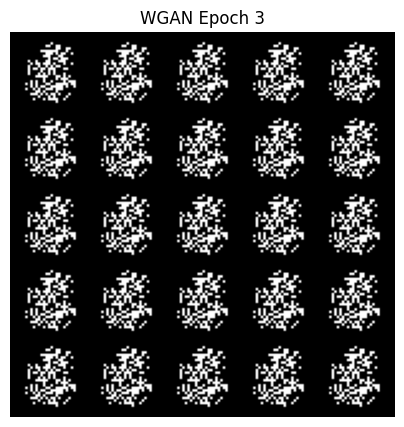

[WGAN] Epoch [4/50]  D_loss: -11.4691  G_loss: -15.7643


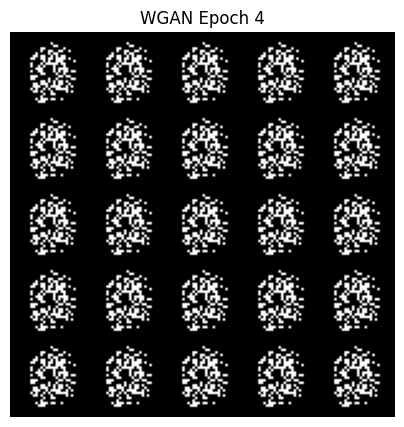

[WGAN] Epoch [5/50]  D_loss: -12.1223  G_loss: -17.9508


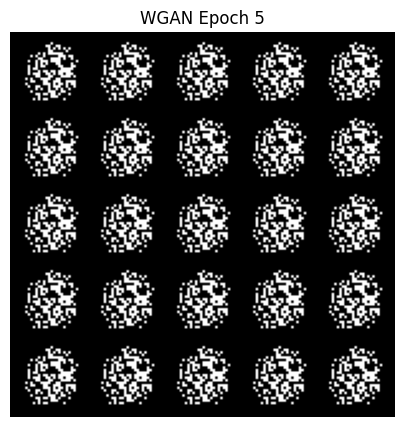

[WGAN] Epoch [6/50]  D_loss: -17.7875  G_loss: -20.1233


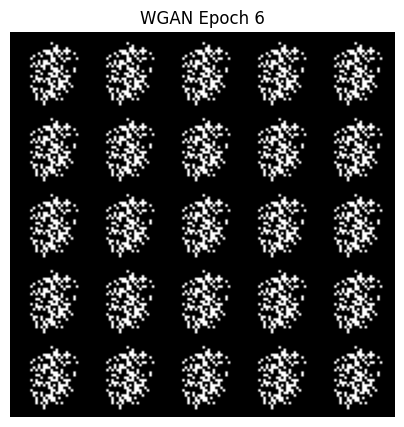

[WGAN] Epoch [7/50]  D_loss: -17.4491  G_loss: -20.2169


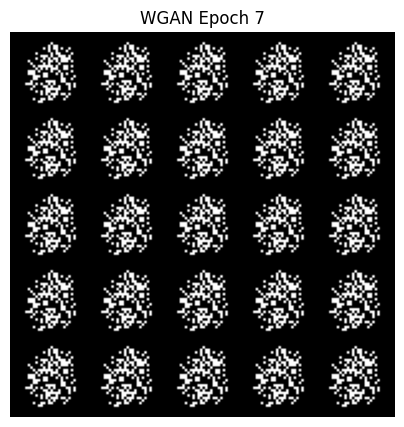

[WGAN] Epoch [8/50]  D_loss: -15.4568  G_loss: -20.6474


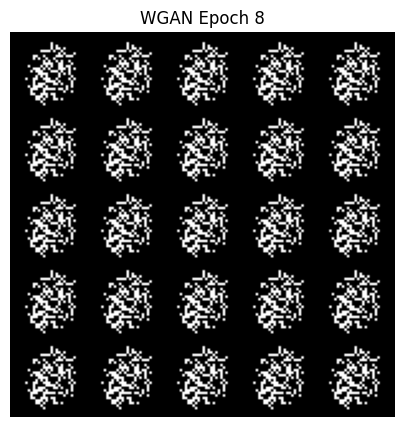

[WGAN] Epoch [9/50]  D_loss: -19.1040  G_loss: -21.6682


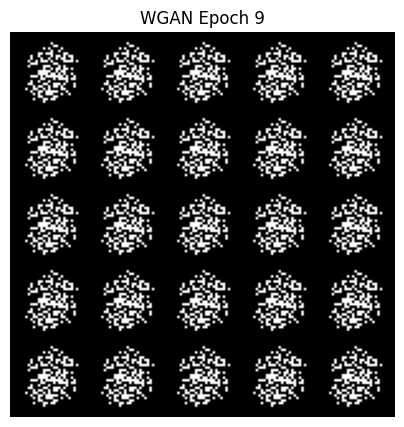

[WGAN] Epoch [10/50]  D_loss: -15.7951  G_loss: -24.6380


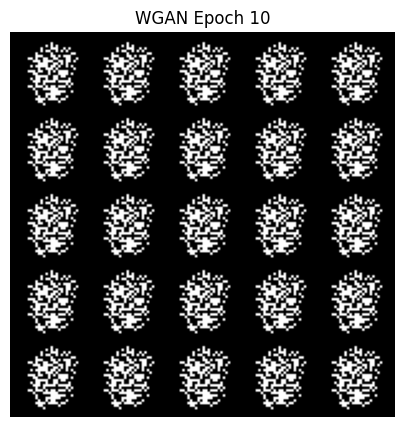

[WGAN] Epoch [11/50]  D_loss: -14.6612  G_loss: -21.6344


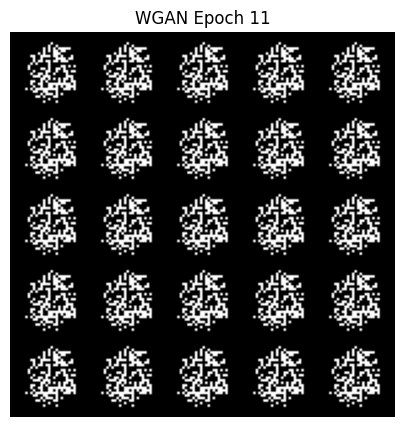

[WGAN] Epoch [12/50]  D_loss: -21.1563  G_loss: -23.2205


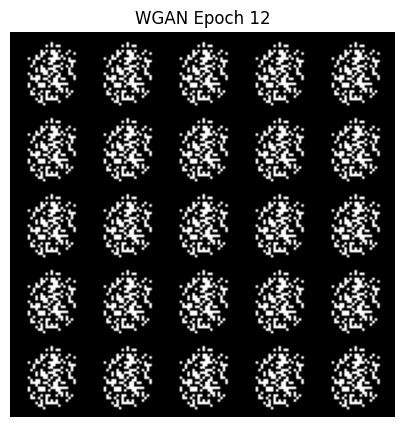

[WGAN] Epoch [13/50]  D_loss: -18.5015  G_loss: -22.8400


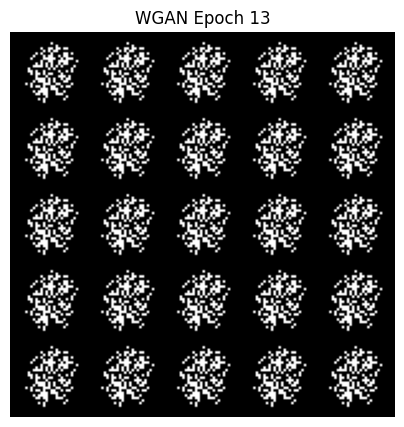

[WGAN] Epoch [14/50]  D_loss: -17.8115  G_loss: -23.7257


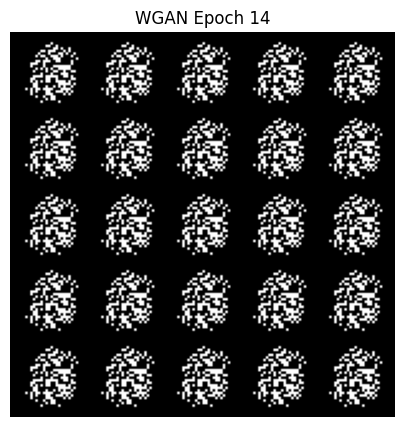

[WGAN] Epoch [15/50]  D_loss: -20.6139  G_loss: -22.9006


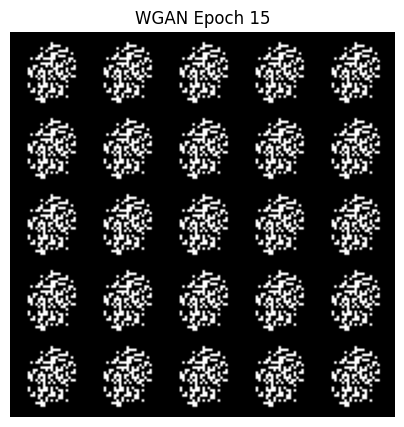

[WGAN] Epoch [16/50]  D_loss: -21.3005  G_loss: -24.0358


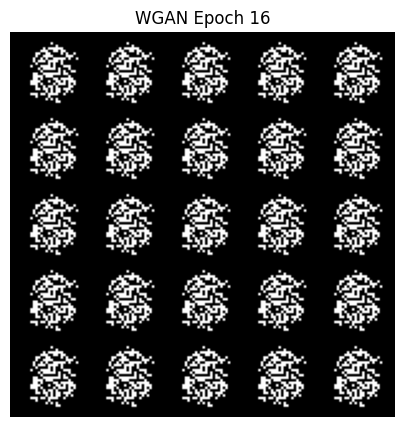

[WGAN] Epoch [17/50]  D_loss: -18.9505  G_loss: -21.8481


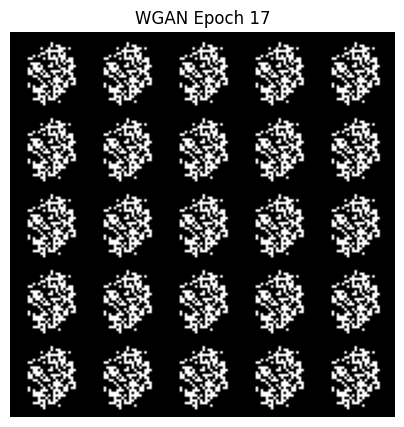

[WGAN] Epoch [18/50]  D_loss: -23.3972  G_loss: -24.3643


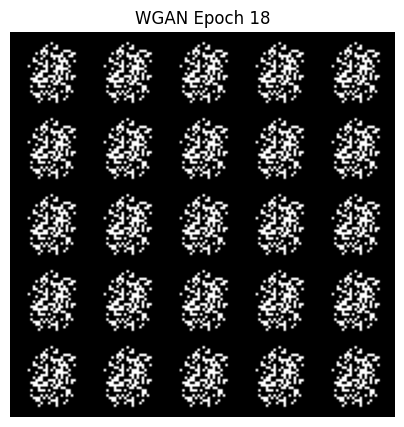

[WGAN] Epoch [19/50]  D_loss: -21.8348  G_loss: -25.0376


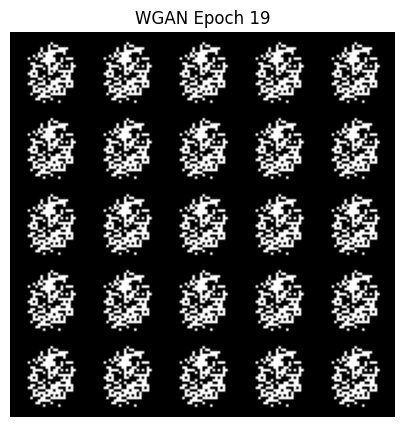

[WGAN] Epoch [20/50]  D_loss: -20.2932  G_loss: -23.9099


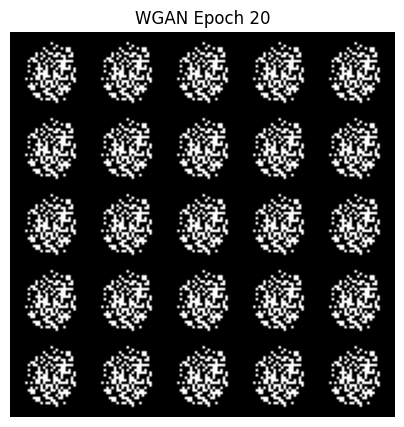

[WGAN] Epoch [21/50]  D_loss: -23.4879  G_loss: -23.5020


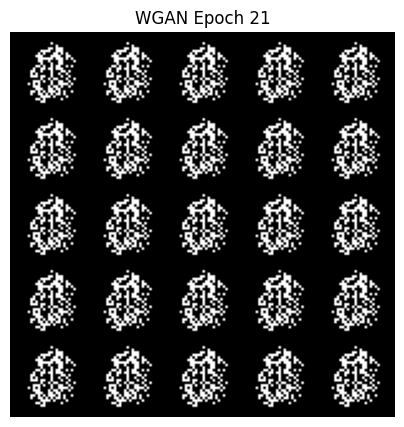

[WGAN] Epoch [22/50]  D_loss: -26.5774  G_loss: -24.3122


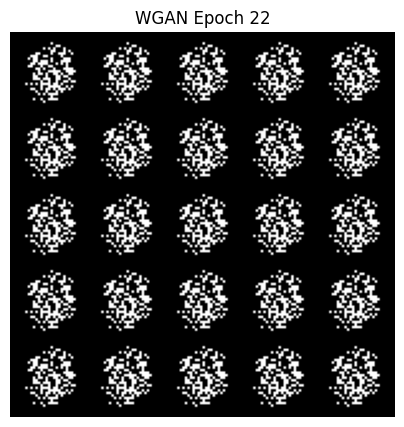

[WGAN] Epoch [23/50]  D_loss: -22.9974  G_loss: -24.1472


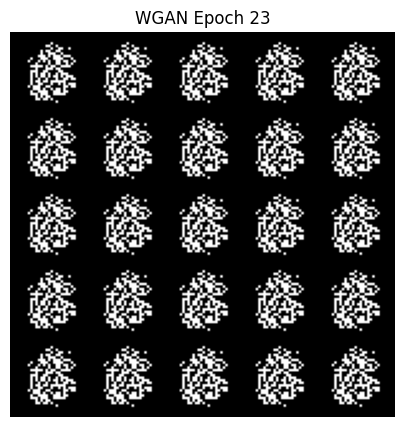

[WGAN] Epoch [24/50]  D_loss: -22.5649  G_loss: -23.5324


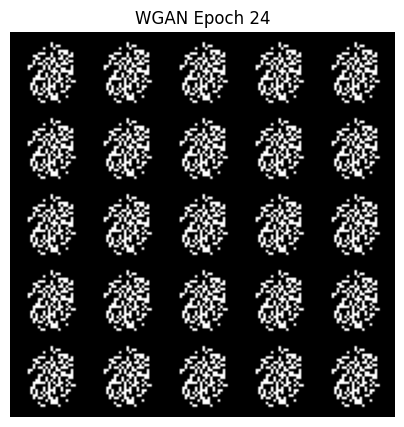

[WGAN] Epoch [25/50]  D_loss: -22.1484  G_loss: -22.9356


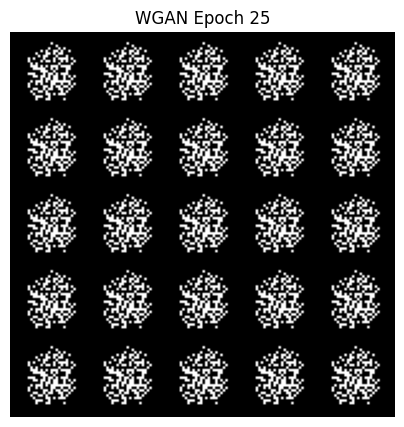

[WGAN] Epoch [26/50]  D_loss: -20.9956  G_loss: -24.2442


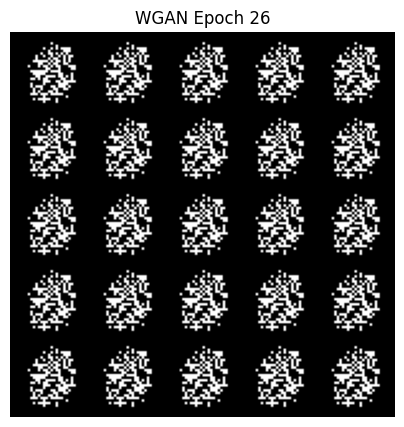

[WGAN] Epoch [27/50]  D_loss: -21.0494  G_loss: -23.1200


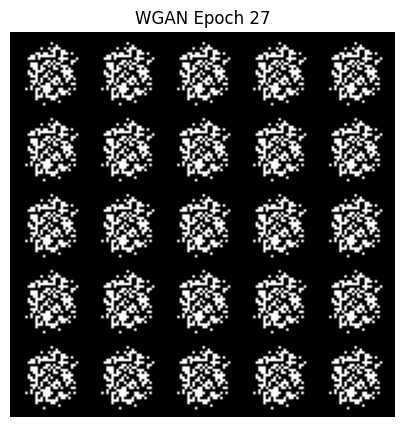

[WGAN] Epoch [28/50]  D_loss: -19.1856  G_loss: -22.4404


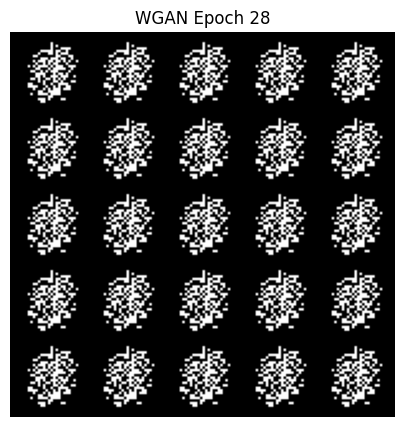

[WGAN] Epoch [29/50]  D_loss: -22.8168  G_loss: -23.3273


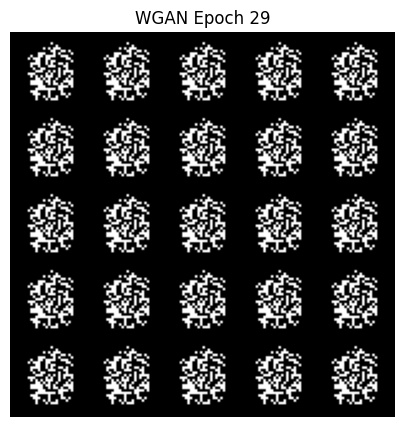

[WGAN] Epoch [30/50]  D_loss: -23.0254  G_loss: -22.8635


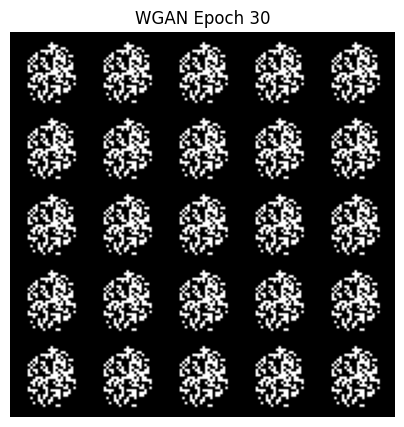

[WGAN] Epoch [31/50]  D_loss: -22.5772  G_loss: -22.5520


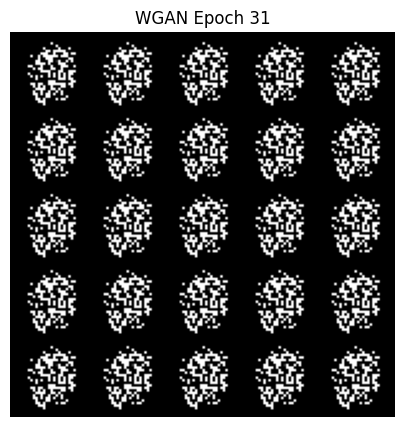

[WGAN] Epoch [32/50]  D_loss: -20.9918  G_loss: -21.3346


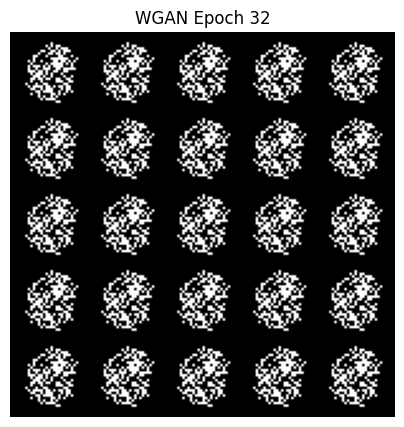

[WGAN] Epoch [33/50]  D_loss: -22.6539  G_loss: -23.1920


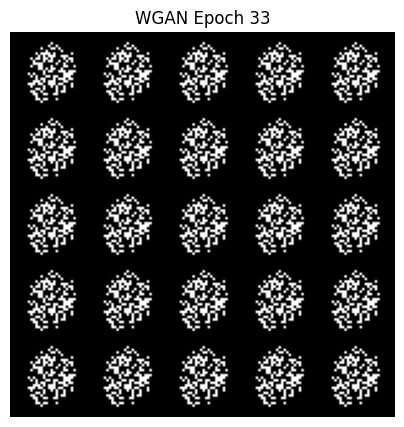

[WGAN] Epoch [34/50]  D_loss: -23.8266  G_loss: -23.9534


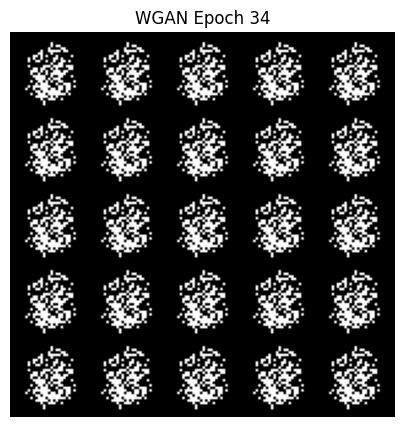

[WGAN] Epoch [35/50]  D_loss: -23.5677  G_loss: -22.9463


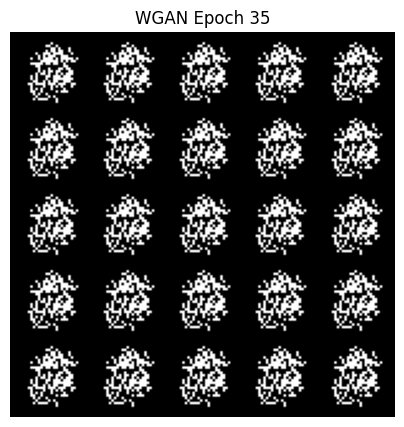

[WGAN] Epoch [36/50]  D_loss: -22.5417  G_loss: -21.6989


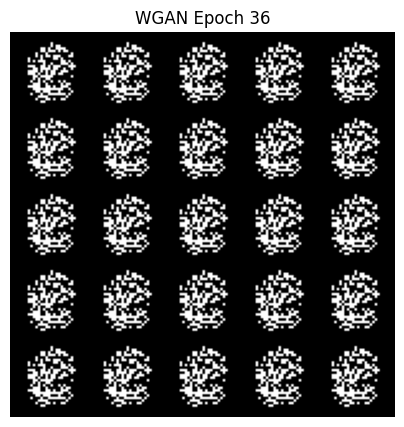

[WGAN] Epoch [37/50]  D_loss: -25.0621  G_loss: -23.4778


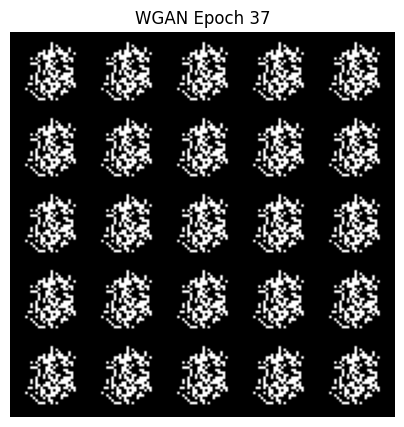

[WGAN] Epoch [38/50]  D_loss: -24.3666  G_loss: -21.9182


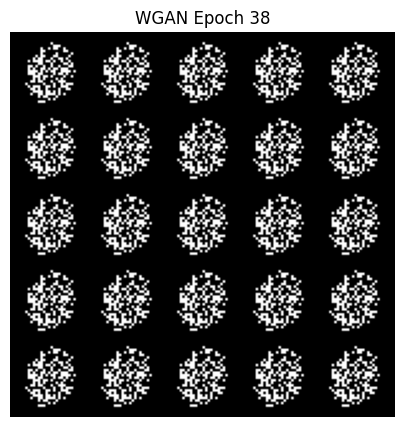

[WGAN] Epoch [39/50]  D_loss: -24.1677  G_loss: -23.0565


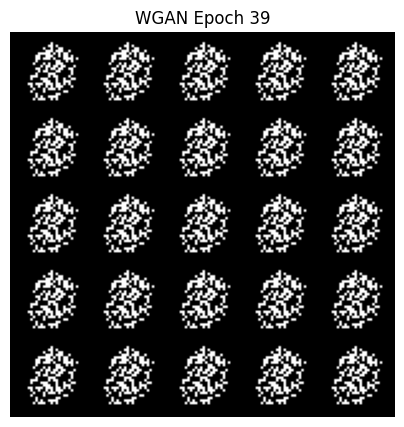

[WGAN] Epoch [40/50]  D_loss: -21.0359  G_loss: -20.8756


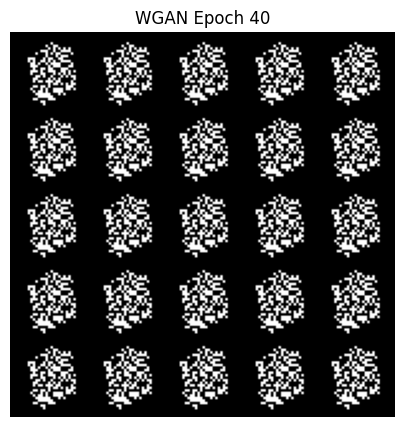

[WGAN] Epoch [41/50]  D_loss: -26.7907  G_loss: -22.6805


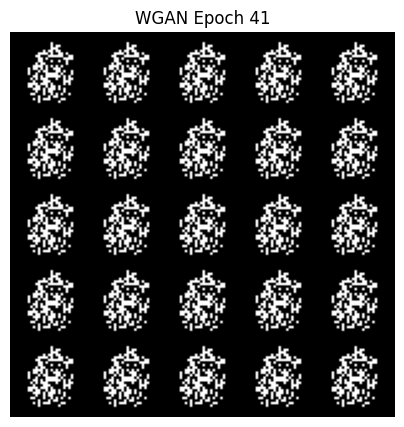

[WGAN] Epoch [42/50]  D_loss: -25.7166  G_loss: -22.7714


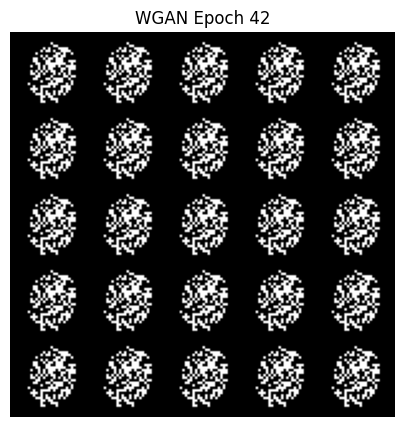

[WGAN] Epoch [43/50]  D_loss: -23.9987  G_loss: -22.5552


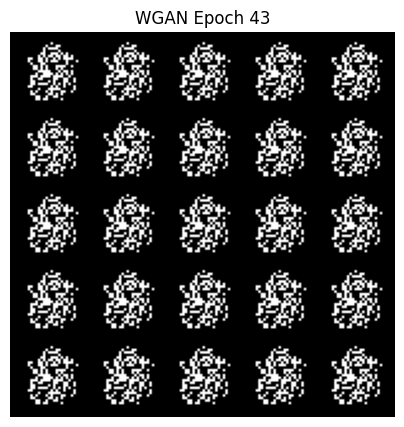

[WGAN] Epoch [44/50]  D_loss: -27.3832  G_loss: -23.4527


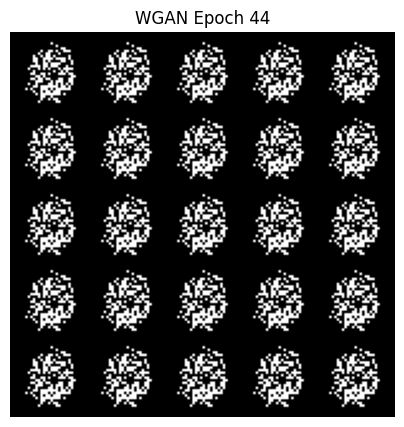

[WGAN] Epoch [45/50]  D_loss: -24.3200  G_loss: -23.6783


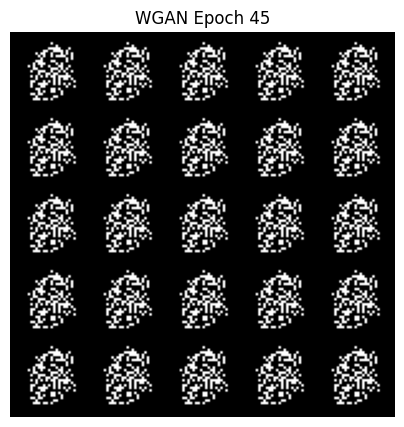

[WGAN] Epoch [46/50]  D_loss: -25.9747  G_loss: -23.2390


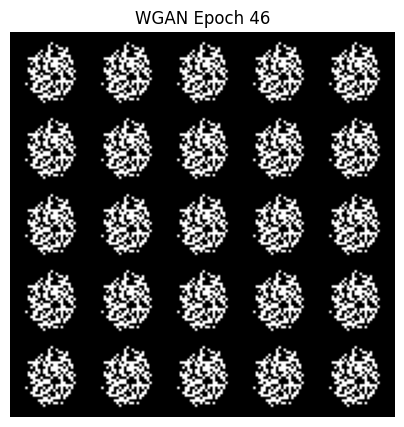

[WGAN] Epoch [47/50]  D_loss: -26.0563  G_loss: -23.1373


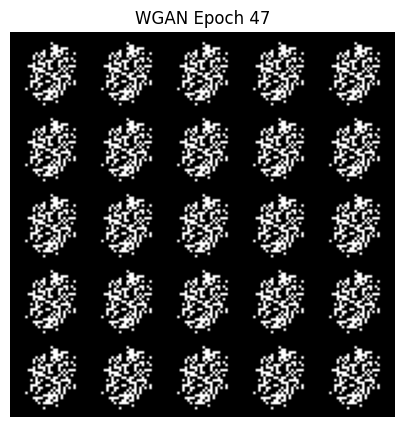

[WGAN] Epoch [48/50]  D_loss: -26.4579  G_loss: -23.2475


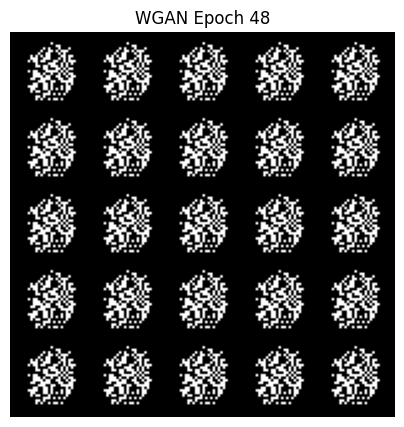

[WGAN] Epoch [49/50]  D_loss: -29.8378  G_loss: -23.4195


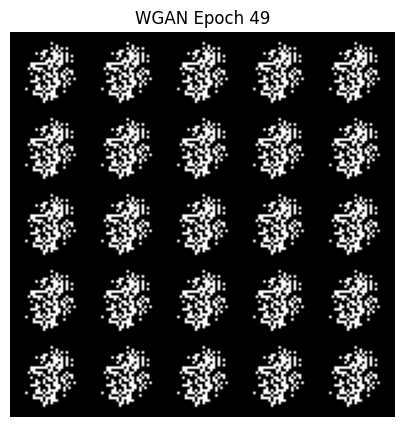

[WGAN] Epoch [50/50]  D_loss: -26.0032  G_loss: -21.5958


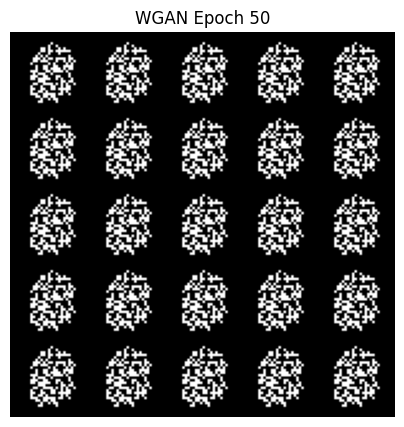

In [ ]:
# 3. WGAN
print("\n========== Training WGAN ==========\n")

wgan_g_losses, wgan_d_losses = train_WGAN(weight_clipping_limit=0.01)